# Widerface EDA

In [437]:
import os
import numpy as np
import pandas as pd
import cv2
from scipy.io import loadmat
import matplotlib.pyplot as plt
%matplotlib inline
import matplotlib.patches as patches
import seaborn as sns
plt.style.use('ggplot')


## Training data

In [3]:
DATA_DIR = './data/widerface'

In [17]:
!head -n 8 ./data/widerface/train/label.txt

# 0--Parade/0_Parade_marchingband_1_849.jpg
449 330 122 149 488.906 373.643 0.0 542.089 376.442 0.0 515.031 412.83 0.0 485.174 425.893 0.0 538.357 431.491 0.0 0.82
# 0--Parade/0_Parade_Parade_0_904.jpg
361 98 263 339 424.143 251.656 0.0 547.134 232.571 0.0 494.121 325.875 0.0 453.83 368.286 0.0 561.978 342.839 0.0 0.89
# 0--Parade/0_Parade_marchingband_1_799.jpg
78 221 7 8 -1.0 -1.0 -1.0 -1.0 -1.0 -1.0 -1.0 -1.0 -1.0 -1.0 -1.0 -1.0 -1.0 -1.0 -1.0 0.2
78 238 14 17 84.188 244.607 1.0 89.527 244.491 1.0 86.973 247.857 1.0 85.116 250.643 1.0 88.482 250.643 1.0 0.36
113 212 11 15 117.0 220.0 0.0 122.0 220.0 0.0 119.0 222.0 0.0 118.0 225.0 0.0 122.0 225.0 0.0 0.3


In [151]:
def parse_label_line(line):
    label = line.split(' ')
    label = [float(x) for x in label]
    bbox = label[:4]
    bbox[2] += bbox[0]
    bbox[3] += bbox[1]
    landmarks = [label[i] for i in [4, 5, 7, 8, 10, 11, 13, 14, 16, 17]]
    if label[4] < 0:
        landmarks.append(-1)
    else:
        landmarks.append(1)
    return bbox + landmarks

def load_train_labels(file_name):
    with open(file_name, 'r') as f:
        lines = [x.rstrip() for x in f.readlines()]
    
    labels = []
    for line in lines:
        if line.startswith('#'):
            names = line[2:].split('/')
            event_name = names[0]
            img_name = names[1].split('.')[0]
            
            labels.append({
                'event_name': event_name,
                'img_name': img_name,
                'annotation': []
            })
        else:
            labels[-1]['annotation'].append(parse_label_line(line))
    
    return pd.DataFrame(labels)

In [152]:
train = load_train_labels(f'{DATA_DIR}/train/label.txt')

In [153]:
train.head()

,event_name,img_name,annotation
0,0--Parade,0_Parade_marchingband_1_849,"[[449.0, 330.0, 571.0, 479.0, 488.906, 373.643..."
1,0--Parade,0_Parade_Parade_0_904,"[[361.0, 98.0, 624.0, 437.0, 424.143, 251.656,..."
2,0--Parade,0_Parade_marchingband_1_799,"[[78.0, 221.0, 85.0, 229.0, -1.0, -1.0, -1.0, ..."
3,0--Parade,0_Parade_marchingband_1_117,"[[69.0, 359.0, 119.0, 395.0, 92.232, 391.397, ..."
4,0--Parade,0_Parade_marchingband_1_778,"[[27.0, 226.0, 60.0, 262.0, -1.0, -1.0, -1.0, ..."


In [154]:
train['num_bboxes'] = train.annotation.map(lambda x: len(x))

In [155]:
train['num_landmarks'] = train.annotation.map(lambda anns: len(list(filter(lambda x: x[4] > 0, anns))))

In [156]:
train.tail()

,event_name,img_name,annotation,num_bboxes,num_landmarks
12875,9--Press_Conference,9_Press_Conference_Press_Conference_9_614,"[[462.0, 140.0, 726.0, 502.0, 489.384, 279.759...",1,1
12876,9--Press_Conference,9_Press_Conference_Press_Conference_9_791,"[[362.0, 108.0, 576.0, 385.0, 414.165, 215.241...",1,1
12877,9--Press_Conference,9_Press_Conference_Press_Conference_9_280,"[[495.0, 222.0, 660.0, 444.0, 541.286, 288.429...",1,1
12878,9--Press_Conference,9_Press_Conference_Press_Conference_9_131,"[[244.0, 46.0, 754.0, 660.0, 284.638, 295.045,...",1,1
12879,9--Press_Conference,9_Press_Conference_Press_Conference_9_266,"[[400.0, 150.0, 608.0, 440.0, 434.455, 252.71,...",1,1


### Total training samples

In [30]:
train.shape

(12880, 3)

### Total bounding boxes / faces

In [49]:
train.num_bboxes.sum()

159424

In [59]:
train.num_bboxes.sum() / train.shape[0]

12.377639751552795

In [56]:
train.num_bboxes.max()

1968

### Total landmarks

In [50]:
train.num_landmarks.sum()

75933

In [60]:
train.num_landmarks.sum() / train.shape[0]

5.8954192546583855

In [58]:
train.num_landmarks.max()

269

We can see that there are 50% bounding boxes / faces have corresponding landmarks.

### Face / landmark number distribution

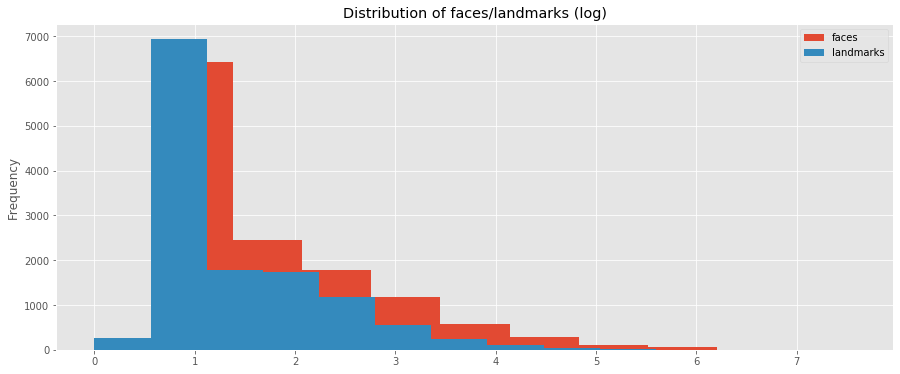

In [368]:
plt.figure(figsize=(15, 6))
plt.title('Distribution of faces/landmarks (log)');
np.log1p(train['num_bboxes']).plot(kind='hist', label='faces');
np.log1p(train['num_landmarks']).plot(kind='hist', label='landmarks');
plt.legend();


In [85]:
np.log1p(1)

0.6931471805599453

In [86]:
print(train[train['num_bboxes']==1].shape[0], train[train['num_bboxes']==2].shape[0], train[train['num_bboxes']==3].shape[0])

4635 1793 827


In [91]:
train[train['num_bboxes']<=12].shape[0] / train.shape[0]

0.8033385093167702

Insights: 80% images have less than 13 faces

In [87]:
print(train[train['num_landmarks']==1].shape[0], train[train['num_landmarks']==2].shape[0], train[train['num_landmarks']==3].shape[0])

4976 1959 987


### Events

In [416]:
train['event_name'].unique()

array(['0--Parade', '1--Handshaking', '10--People_Marching',
       '11--Meeting', '12--Group', '13--Interview', '14--Traffic',
       '15--Stock_Market', '16--Award_Ceremony', '17--Ceremony',
       '18--Concerts', '19--Couple', '2--Demonstration',
       '20--Family_Group', '21--Festival', '22--Picnic', '23--Shoppers',
       '24--Soldier_Firing', '25--Soldier_Patrol', '26--Soldier_Drilling',
       '27--Spa', '28--Sports_Fan', '29--Students_Schoolkids', '3--Riot',
       '30--Surgeons', '31--Waiter_Waitress', '32--Worker_Laborer',
       '33--Running', '34--Baseball', '35--Basketball', '36--Football',
       '37--Soccer', '38--Tennis', '39--Ice_Skating', '4--Dancing',
       '40--Gymnastics', '41--Swimming', '42--Car_Racing', '43--Row_Boat',
       '44--Aerobics', '45--Balloonist', '46--Jockey',
       '47--Matador_Bullfighter', '48--Parachutist_Paratrooper',
       '49--Greeting', '5--Car_Accident', '50--Celebration_Or_Party',
       '51--Dresses', '52--Photographers', '53--Raid', 

### Image distribution per event

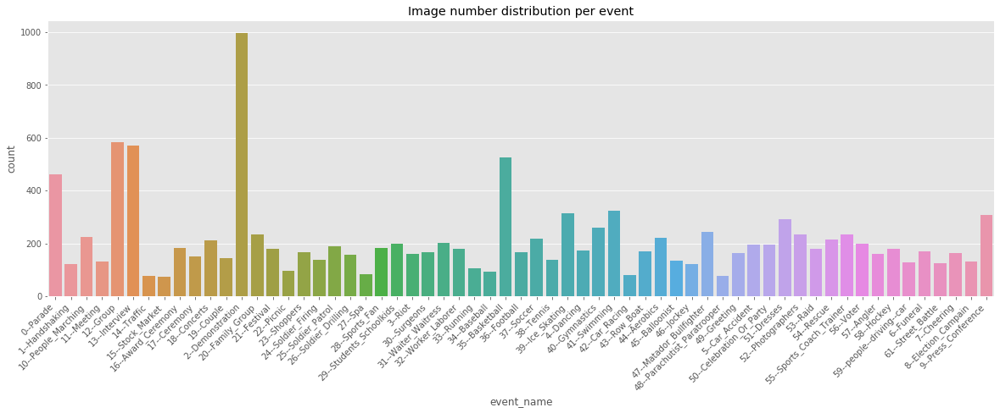

In [414]:
plt.figure(figsize=(20, 6))
chart=sns.countplot(x='event_name', data=train)
chart.set_xticklabels(chart.get_xticklabels(), rotation=45, horizontalalignment='right')
plt.title('Image number distribution per event');

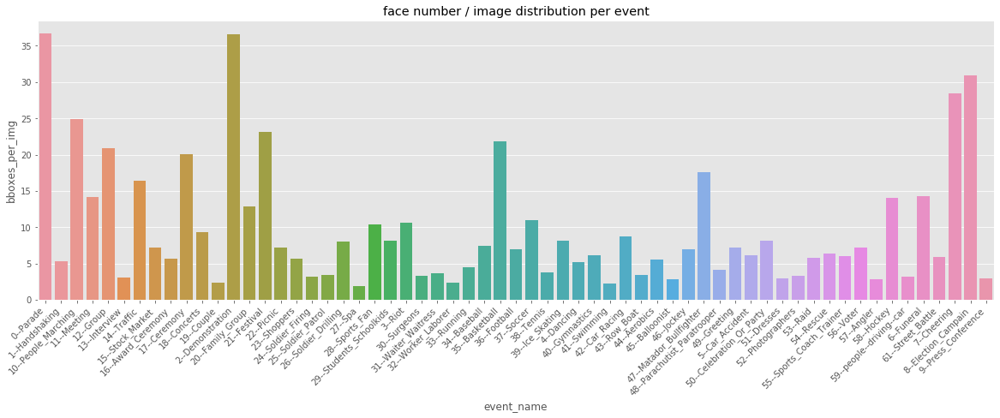

In [412]:
train_sum = pd.concat([train.groupby('event_name').count().drop(['num_bboxes', 'num_landmarks'], axis=1), train.groupby('event_name').sum()], axis=1)
train_sum['bboxes_per_img'] = train_sum.num_bboxes / train_sum.img_name

plt.figure(figsize=(20, 6))
chart=sns.barplot(x='event_name', y='bboxes_per_img', data=train_sum.reset_index())
chart.set_xticklabels(chart.get_xticklabels(), rotation=45, horizontalalignment='right')
plt.title('face number / image distribution per event');


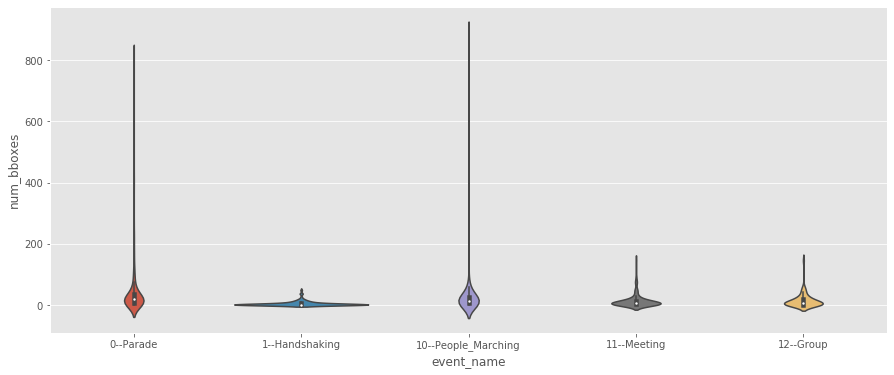

In [413]:
plt.figure(figsize=(15, 6))
sns.violinplot(x='event_name', y='num_bboxes', data=train[:1000]);

# Check training images

In [435]:
def show_images(df, mode='train'):
    image_count = df.shape[0]
    n = image_count
    assert n <= 16
    row_count = (int) (image_count / n)
    fig, ax = plt.subplots(row_count, n, figsize=(20,10))
    for i, (idx, row) in enumerate(df.iterrows()):
        #print(row)
        x = (int)(i/n)
        y = i%n
        tuple_index = (x,y) if row_count > 1 else y
        
        img_path = f'{DATA_DIR}/{mode}/images/{row.event_name}/{row.img_name}.jpg'
        #print(img_path)
        ax[tuple_index].imshow(cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB))
        ax[tuple_index].set_title(f'{row.event_name}/{row.img_name}')
        ax[tuple_index].grid(False)

        # Draw bounding boxes
        for box_idx, bbox in enumerate(row.annotation):
            #print(bbox)
            edgecolor = 'r'
            if mode == 'val':
                if box_idx in row.hard_gt:
                    edgecolor = 'c'
                if box_idx in row.medium_gt:
                    edgecolor = 'b'
                if box_idx in row.easy_gt:
                    edgecolor = 'g'
            rect = patches.Rectangle((bbox[0],bbox[1]),bbox[2]-bbox[0],bbox[3]-bbox[1],linewidth=2,edgecolor=edgecolor,facecolor='none')
            ax[tuple_index].add_patch(rect)
        
        # Draw landmarks
        if mode == 'train':
            for ann in row.annotation:
                if ann[4] > 0:
                    for lm_idx in range(5):
                        x, y = ann[4:][lm_idx*2:lm_idx*2+2]
                        lm = patches.Circle((x, y), radius=3, fill=True, color='g')
                        ax[tuple_index].add_patch(lm)
    fig.show()


def show_random_images(df, n=3, mode='train'):
    show_images(df.sample(n), mode=mode)


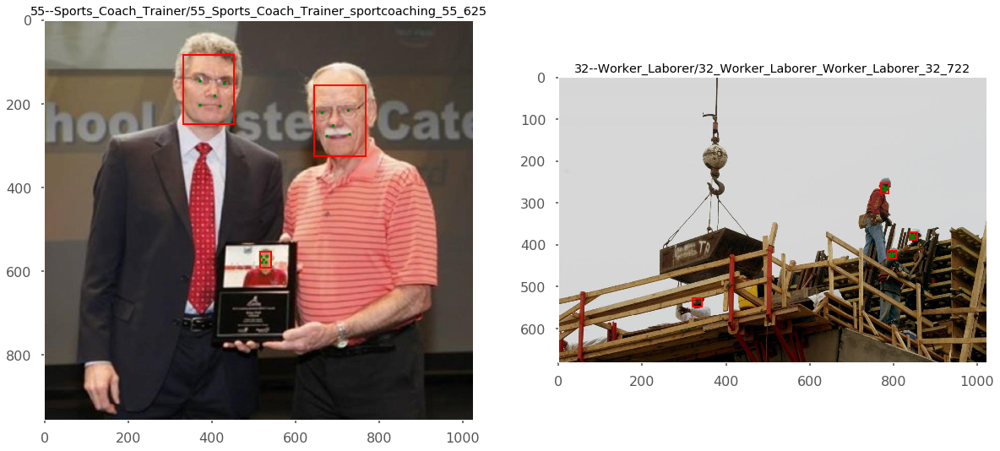

In [438]:
show_random_images(train, 2)

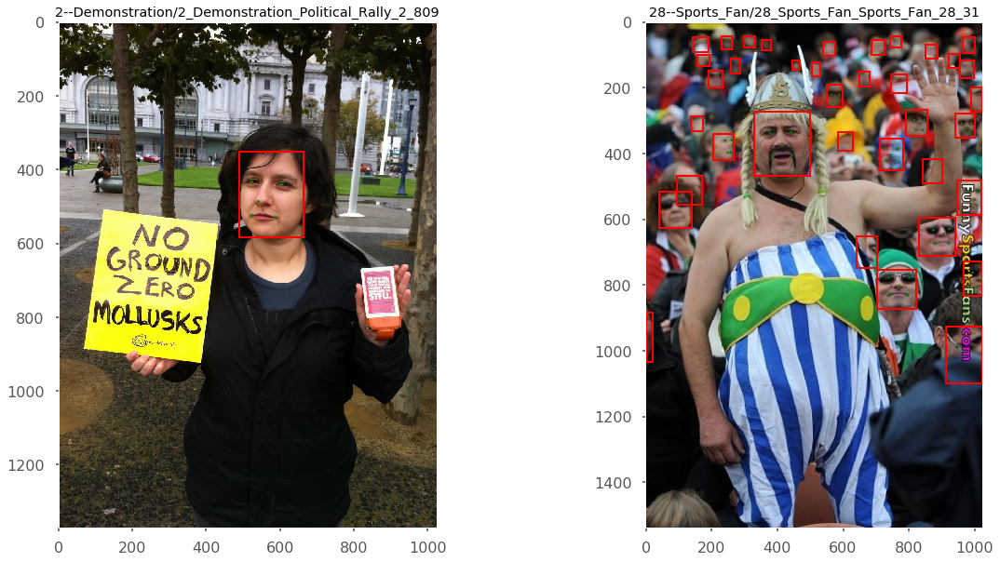

In [440]:
show_random_images(train, 2)

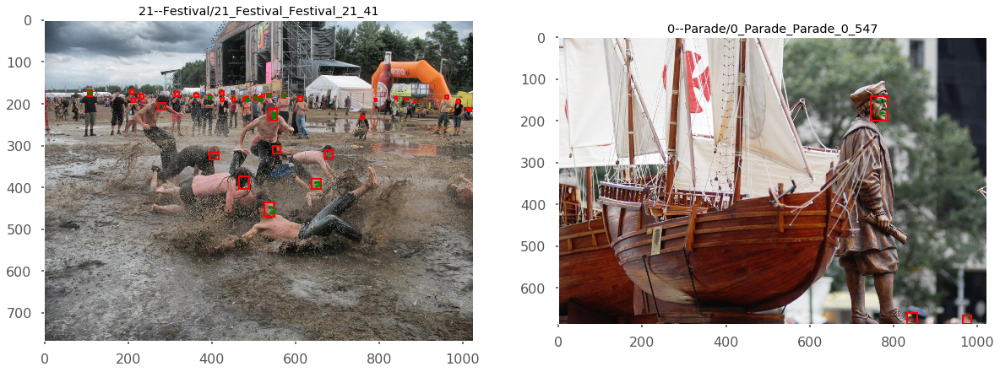

In [441]:
show_random_images(train[train['num_landmarks'] < train['num_bboxes']], 2)

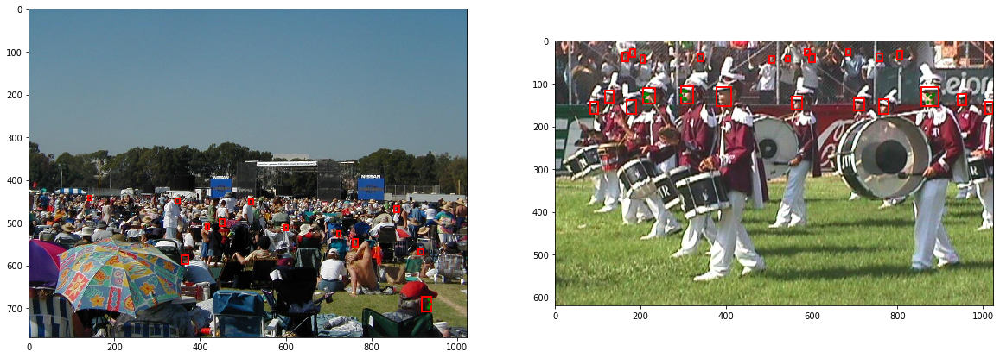

In [193]:
show_random_images(train[train['num_landmarks'] < train['num_bboxes']], 2)

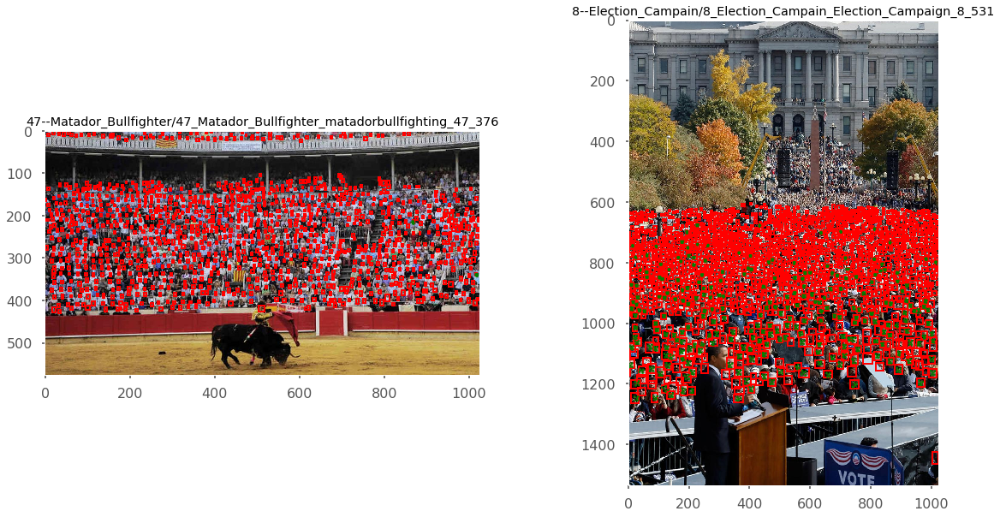

In [442]:
show_random_images(train[train['num_bboxes'] > 1000], 2)

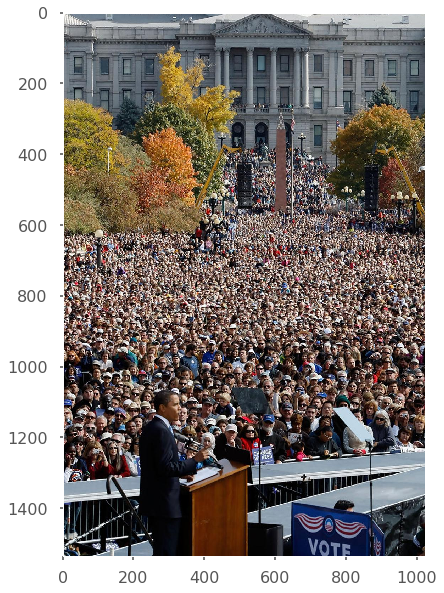

In [560]:
plt.figure(figsize=(20, 10))
img_path = f'{DATA_DIR}/train/images/8--Election_Campain/8_Election_Campain_Election_Campaign_8_531.jpg'
plt.imshow(cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB))
plt.grid(False)

# Evaluation data

In [321]:
def get_gt_boxes(gt_dir):
    """ gt dir: (wider_face_val.mat, wider_easy_val.mat, wider_medium_val.mat, wider_hard_val.mat)"""

    gt_mat = loadmat(os.path.join(gt_dir, 'wider_face_val.mat'))
    hard_mat = loadmat(os.path.join(gt_dir, 'wider_hard_val.mat'))
    medium_mat = loadmat(os.path.join(gt_dir, 'wider_medium_val.mat'))
    easy_mat = loadmat(os.path.join(gt_dir, 'wider_easy_val.mat'))

    facebox_list = gt_mat['face_bbx_list']
    event_list = gt_mat['event_list']
    file_list = gt_mat['file_list']

    hard_gt_list = hard_mat['gt_list']
    medium_gt_list = medium_mat['gt_list']
    easy_gt_list = easy_mat['gt_list']

    return facebox_list, event_list, file_list, hard_gt_list, medium_gt_list, easy_gt_list

In [322]:
facebox_list, event_list, file_list, hard_gt_list, medium_gt_list, easy_gt_list = get_gt_boxes('./widerface_evaluate/ground_truth/')

In [224]:
facebox_list[0][0][0][0].shape

(126, 4)

In [250]:
facebox_list[0].shape

(1,)

In [244]:
event_list[1]

array([array(['1--Handshaking'], dtype='<U14')], dtype=object)

In [258]:
hard_gt_list[0].shape

(1,)

In [230]:
file_list[0][0].shape

(115, 1)

In [323]:
val_labels = []
for faceboxes, events, files, hard_gt, medium_gt, easy_gt \
    in zip(facebox_list, event_list, file_list, hard_gt_list, medium_gt_list, easy_gt_list):
    #print(facebox[0].shape, event_list)
    for i, file in enumerate(files[0]):
        #print(file[0][0], i)
        #print(events[0][0])
        #print(faceboxes[0][i][0])
        #print(hard_gt[0][i][0])
        #print(medium_gt[0][i][0])
        #print(easy_gt[0][i][0])
        #if i == 1:
        #    break
        #if file[0][0] == '16_Award_Ceremony_Awards_Ceremony_16_750':
        #    print(hard_gt[0][i][0], hard_gt[0][i][0].squeeze(-1))
        faceboxes[0][i][0][:, 2] += faceboxes[0][i][0][:, 0]
        faceboxes[0][i][0][:, 3] += faceboxes[0][i][0][:, 1]
        
        if hard_gt[0][i][0].shape[1] == 0:
            h = hard_gt[0][i][0].squeeze()
        else:
            h = hard_gt[0][i][0].squeeze(-1)
        if medium_gt[0][i][0].shape[1] == 0:
            m = medium_gt[0][i][0].squeeze()
        else:
            m = medium_gt[0][i][0].squeeze(-1)
        if easy_gt[0][i][0].shape[1] == 0:
            e = easy_gt[0][i][0].squeeze()
        else:
            e = easy_gt[0][i][0].squeeze(-1)
        
        val_labels.append({
            'event_name': events[0][0],
            'img_name': file[0][0],
            'annotation': faceboxes[0][i][0],
            'hard_gt': h-1,
            'medium_gt': m-1,
            'easy_gt': e-1
        })
    #break

In [324]:
val = pd.DataFrame(val_labels)
val['num_bboxes'] = val.annotation.map(lambda x: len(x))
val.head()

,event_name,img_name,annotation,hard_gt,medium_gt,easy_gt,num_bboxes
0,0--Parade,0_Parade_marchingband_1_465,"[[345, 211, 349, 215], [331, 126, 334, 129], [...","[30, 31, 124]",[],[],126
1,0--Parade,0_Parade_Parade_0_628,"[[26, 299, 36, 315], [25, 329, 32, 340], [84, ...","[0, 1, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20,...","[12, 14, 15]",[],29
2,0--Parade,0_Parade_marchingband_1_765,"[[311, 131, 319, 140], [299, 143, 309, 154], [...","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...",[],[],132
3,0--Parade,0_Parade_Parade_0_194,"[[111, 425, 233, 552], [209, 347, 279, 450], [...","[0, 1, 2, 3, 4]","[0, 1, 2, 3, 4]","[0, 1, 2, 3, 4]",5
4,0--Parade,0_Parade_marchingband_1_379,"[[281, 303, 301, 339], [260, 324, 276, 345], [...","[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 17, 18, 20,...","[0, 3, 21, 22]",[],26


In [554]:
val.shape

(3226, 7)

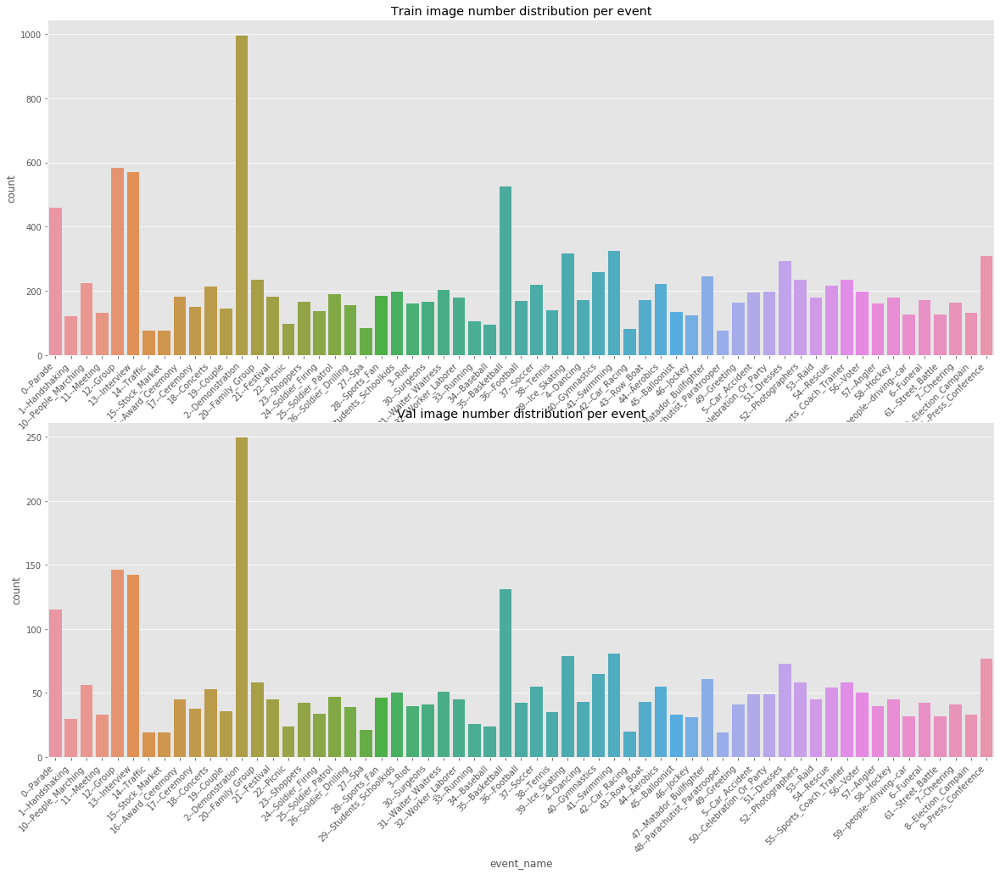

In [408]:
fig, ax = plt.subplots(figsize = (20, 16))
plt.subplot(2, 1, 1)
#plt.figure(figsize=(20, 6))
chart=sns.countplot(x='event_name', data=train)
chart.set_xticklabels(chart.get_xticklabels(), rotation=45, horizontalalignment='right')
plt.title('Train image number distribution per event');

plt.subplot(2, 1, 2)
chart=sns.countplot(x='event_name', data=val)
chart.set_xticklabels(chart.get_xticklabels(), rotation=45, horizontalalignment='right')
plt.title('Val image number distribution per event');


Text(0.5, 1.0, 'Val face number / image distribution per event')

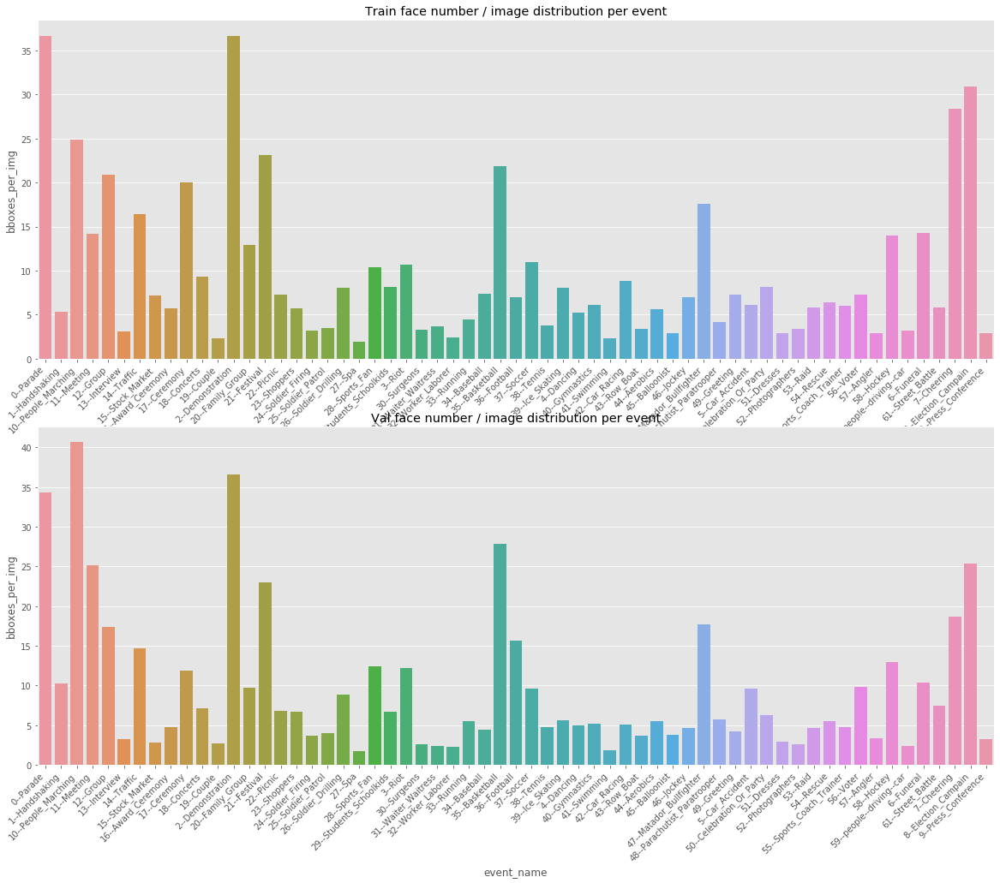

In [411]:
val_sum = pd.concat([val.groupby('event_name').count().drop(['num_bboxes'], axis=1), val.groupby('event_name').sum()], axis=1)
val_sum['bboxes_per_img'] = val_sum.num_bboxes / val_sum.img_name

fig, ax = plt.subplots(figsize = (20, 16))
plt.subplot(2, 1, 1)

#plt.figure(figsize=(20, 6))
chart=sns.barplot(x='event_name', y='bboxes_per_img', data=train_sum.reset_index())
chart.set_xticklabels(chart.get_xticklabels(), rotation=45, horizontalalignment='right')
plt.title('Train face number / image distribution per event')

plt.subplot(2, 1, 2)

chart=sns.barplot(x='event_name', y='bboxes_per_img', data=val_sum.reset_index())
chart.set_xticklabels(chart.get_xticklabels(), rotation=45, horizontalalignment='right')
plt.title('Val face number / image distribution per event')


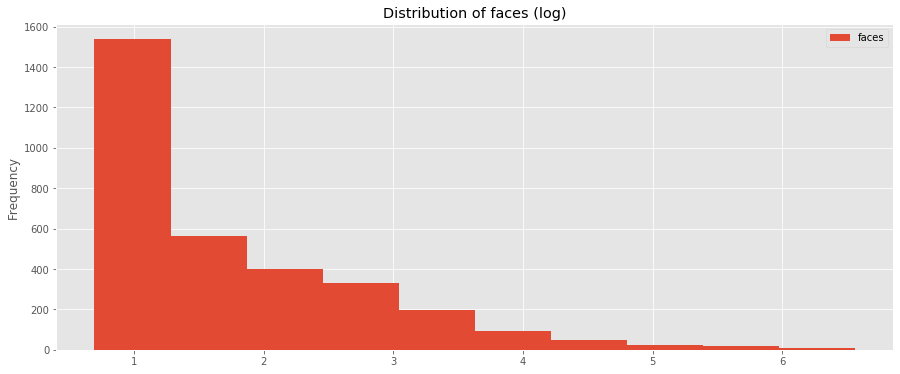

In [403]:
plt.figure(figsize=(15, 6))
plt.title('Distribution of faces (log)');
np.log1p(val['num_bboxes']).plot(kind='hist', label='faces');
plt.legend();

In [332]:
val[1:2]

,event_name,img_name,annotation,hard_gt,medium_gt,easy_gt,num_bboxes
1,0--Parade,0_Parade_Parade_0_628,"[[26, 299, 36, 315], [25, 329, 32, 340], [84, ...","[0, 1, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20,...","[12, 14, 15]",[],29


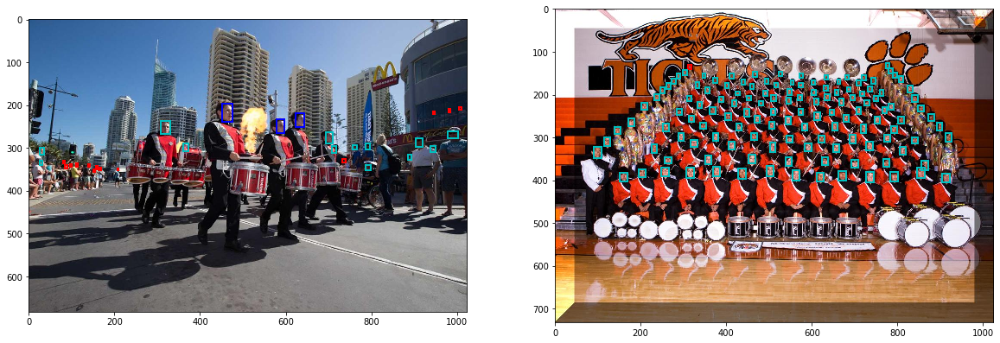

In [352]:
show_random_images(val[1:3], 2, mode='val')

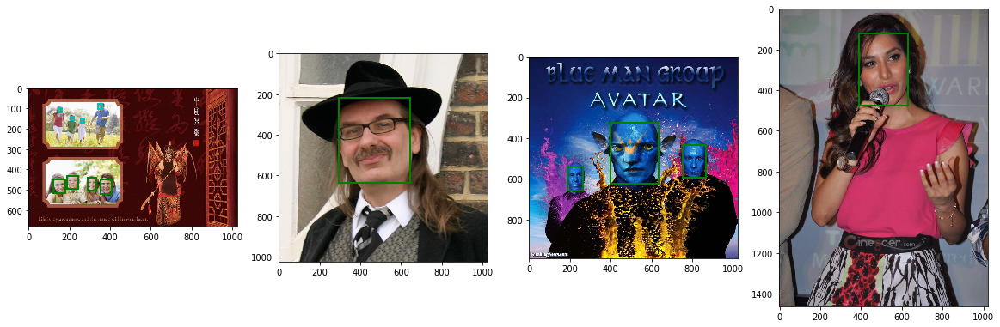

In [353]:
show_random_images(val, 4, mode='val')

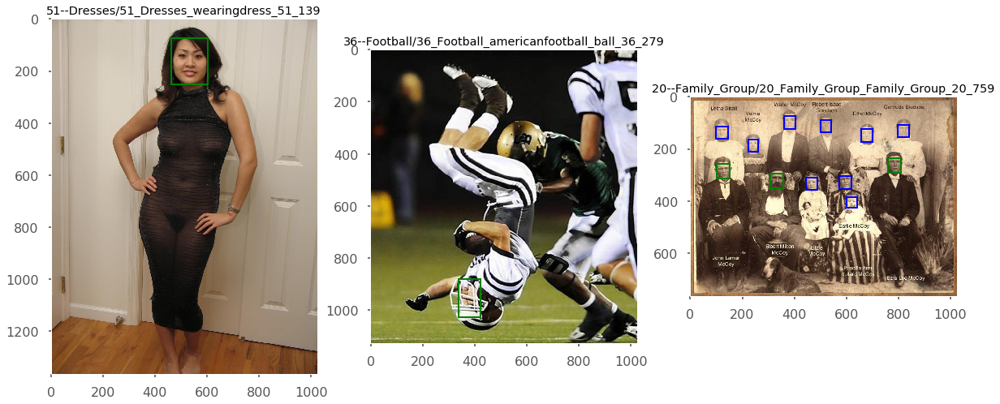

In [446]:
show_random_images(val, 3, mode='val')

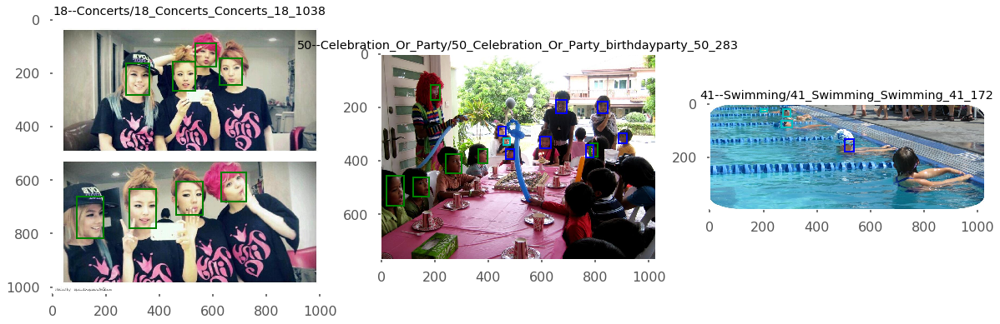

In [448]:
show_random_images(val, 3, mode='val')

# Train /val data insights

* Train and val data distribution are almost identical.
* Images per event and faces per event are unbalanced.
* Long tail distribution of number of faces per image.  80% images have less than 12 faces.  Some images have up to 1800 faces in single image
* Only a half training faces have landmark labels.
* There are different types of faces:
  - Very small faces. (important)
  - Covered by other object (masks, cars, etc).
  - Inside car.
  - Cartoon faces.
  - upside down
  - unclear
  

# Check model predictions

In [467]:
from __future__ import print_function
import os
import argparse
import torch
import torch.backends.cudnn as cudnn
import numpy as np
from data import cfg_mnet, cfg_re50
from layers.functions.prior_box import PriorBox
from utils.nms.py_cpu_nms import py_cpu_nms
import cv2
from models.retinaface import RetinaFace
from utils.box_utils import decode, decode_landm
from utils.timer import Timer
from collections import defaultdict
from tqdm.notebook import tqdm

args = argparse.Namespace()
args.trained_model = './weights/mobilenet0.25_Final.pth'
args.network = 'mobile0.25'
args.origin_size = True
args.save_folder = './widerface_evaluate/widerface_txt/'
args.cpu = False
args.dataset_folder = './data/widerface/val/images/'
args.confidence_threshold = 0.02
args.top_k = 5000
args.nms_threshold = 0.4
args.keep_top_k = 750
args.save_image = False
args.vis_thres = 0.3

cfg = None
if args.network == "mobile0.25":
    cfg = cfg_mnet
elif args.network == "resnet50":
    cfg = cfg_re50

device = torch.device("cpu" if args.cpu else "cuda")

def check_keys(model, pretrained_state_dict):
    ckpt_keys = set(pretrained_state_dict.keys())
    model_keys = set(model.state_dict().keys())
    used_pretrained_keys = model_keys & ckpt_keys
    unused_pretrained_keys = ckpt_keys - model_keys
    missing_keys = model_keys - ckpt_keys
    print('Missing keys:{}'.format(len(missing_keys)))
    print('Unused checkpoint keys:{}'.format(len(unused_pretrained_keys)))
    print('Used keys:{}'.format(len(used_pretrained_keys)))
    assert len(used_pretrained_keys) > 0, 'load NONE from pretrained checkpoint'
    return True


def remove_prefix(state_dict, prefix):
    ''' Old style model is stored with all names of parameters sharing common prefix 'module.' '''
    print('remove prefix \'{}\''.format(prefix))
    f = lambda x: x.split(prefix, 1)[-1] if x.startswith(prefix) else x
    return {f(key): value for key, value in state_dict.items()}


def load_model(model, pretrained_path, load_to_cpu):
    print('Loading pretrained model from {}'.format(pretrained_path))
    if load_to_cpu:
        pretrained_dict = torch.load(pretrained_path, map_location=lambda storage, loc: storage)
    else:
        device = torch.cuda.current_device()
        pretrained_dict = torch.load(pretrained_path, map_location=lambda storage, loc: storage.cuda(device))
    if "state_dict" in pretrained_dict.keys():
        pretrained_dict = remove_prefix(pretrained_dict['state_dict'], 'module.')
    else:
        pretrained_dict = remove_prefix(pretrained_dict, 'module.')
    check_keys(model, pretrained_dict)
    model.load_state_dict(pretrained_dict, strict=False)
    return model

def create_model():
    # net and model
    net = RetinaFace(cfg=cfg, phase = 'test')
    net = load_model(net, args.trained_model, args.cpu)
    net.eval()
    print('Finished loading model!')
    #print(net)
    cudnn.benchmark = True
    
    net = net.to(device)
    return net
    
def create_test_dataset():
    # testing dataset
    testset_folder = args.dataset_folder
    testset_list = args.dataset_folder[:-7] + "wider_val.txt"
    #testset_list = args.dataset_folder[:-7] + "wider_val_half.txt"

    with open(testset_list, 'r') as fr:
        test_dataset = fr.read().split()
    
    return test_dataset

def predict(net, test_dataset):
    torch.set_grad_enabled(False)

    num_images = len(test_dataset)

    _t = {'forward_pass': Timer(), 'misc': Timer()}
    
    testset_folder = args.dataset_folder

    # testing begin
    results = defaultdict(dict)
    for i, img_name in tqdm(enumerate(test_dataset)):
        #print('img_name:', img_name)
        image_path = testset_folder + img_name
        img_raw = cv2.imread(image_path, cv2.IMREAD_COLOR)
        img = np.float32(img_raw)

        # testing scale
        target_size = 1600
        max_size = 2150
        im_shape = img.shape
        im_size_min = np.min(im_shape[0:2])
        im_size_max = np.max(im_shape[0:2])
        resize = float(target_size) / float(im_size_min)
        # prevent bigger axis from being more than max_size:
        if np.round(resize * im_size_max) > max_size:
            resize = float(max_size) / float(im_size_max)
        if args.origin_size:
            resize = 1

        if resize != 1:
            img = cv2.resize(img, None, None, fx=resize, fy=resize, interpolation=cv2.INTER_LINEAR)
        im_height, im_width, _ = img.shape
        scale = torch.Tensor([img.shape[1], img.shape[0], img.shape[1], img.shape[0]])
        img -= (104, 117, 123)
        img = img.transpose(2, 0, 1)
        img = torch.from_numpy(img).unsqueeze(0)
        img = img.to(device)
        scale = scale.to(device)

        _t['forward_pass'].tic()
        loc, conf, landms = net(img)  # forward pass
        _t['forward_pass'].toc()
        _t['misc'].tic()
        priorbox = PriorBox(cfg, image_size=(im_height, im_width))
        priors = priorbox.forward()
        priors = priors.to(device)
        prior_data = priors.data
        boxes = decode(loc.data.squeeze(0), prior_data, cfg['variance'])
        boxes = boxes * scale / resize
        boxes = boxes.cpu().numpy()
        scores = conf.squeeze(0).data.cpu().numpy()[:, 1]
        landms = decode_landm(landms.data.squeeze(0), prior_data, cfg['variance'])
        scale1 = torch.Tensor([img.shape[3], img.shape[2], img.shape[3], img.shape[2],
                               img.shape[3], img.shape[2], img.shape[3], img.shape[2],
                               img.shape[3], img.shape[2]])
        scale1 = scale1.to(device)
        landms = landms * scale1 / resize
        landms = landms.cpu().numpy()

        # ignore low scores
        inds = np.where(scores > args.confidence_threshold)[0]
        boxes = boxes[inds]
        landms = landms[inds]
        scores = scores[inds]
        
        #print('num dets before nms:', len(scores))

        # keep top-K before NMS
        order = scores.argsort()[::-1]
        # order = scores.argsort()[::-1][:args.top_k]
        boxes = boxes[order]
        landms = landms[order]
        scores = scores[order]

        # do NMS
        dets = np.hstack((boxes, scores[:, np.newaxis])).astype(np.float32, copy=False)
        keep = py_cpu_nms(dets, args.nms_threshold)
        # keep = nms(dets, args.nms_threshold,force_cpu=args.cpu)
        dets = dets[keep, :]
        #landms = landms[keep]

        # keep top-K faster NMS
        # dets = dets[:args.keep_top_k, :]
        # landms = landms[:args.keep_top_k, :]

        #dets = np.concatenate((dets, landms), axis=1)
        _t['misc'].toc()
        
        event = img_name.split('/')[1]
        event_img = img_name.split('/')[2][:-4]

        #if event_img not in results[event]:
        dets[:, 2] = dets[:, 2] - dets[:, 0]
        dets[:, 3] = dets[:, 3] - dets[:, 1]
        #print('num final dets:', len(dets))
        results[event][event_img] = dets[:, :5]
        #print('results:', results)
        #print(min(dets[:, 4]))
    return results

In [468]:
test_dataset = create_test_dataset()

In [469]:
net = create_model()

Loading pretrained model from ./weights/mobilenet0.25_Final.pth
remove prefix 'module.'
Missing keys:0
Unused checkpoint keys:0
Used keys:300
Finished loading model!


In [488]:
results = predict(net, test_dataset)

In [471]:
from widerface_evaluate.evaluation import evaluation
%load_ext autoreload
%autoreload 2

In [477]:
evaluation(results, './widerface_evaluate/ground_truth/')



  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing medium:  69%|██████▉   | 42/61 [00:03<00:01,  9.91it/s]

Processing medium:  75%|███████▌  | 46/61 [00:03<00:02,  6.42it/s]

Processing medium:  75%|███████▌  | 46/61 [00:03<00:02,  6.42it/s]

Processing medium:  75%|███████▌  | 46/61 [00:03<00:02,  6.42it/s]

Processing medium:  75%|███████▌  | 46/61 [00:04<00:02,  6.42it/s]

Processing medium:  80%|████████  | 49/61 [00:04<00:02,  4.27it/s]

Processing medium:  80%|████████  | 49/61 [00:04<00:02,  4.27it/s]

Processing medium:  80%|████████  | 49/61 [00:05<00:02,  4.27it/s]

Processing medium:  84%|████████▎ | 51/61 [00:05<00:02,  3.47it/s]

Processing medium:  84%|████████▎ | 51/61 [00:05<00:02,  3.47it/s]

Processing medium:  84%|████████▎ | 51/61 [00:05<00:02,  3.47it/s]

Processing medium:  87%|████████▋ | 53/61 [00:06<00:02,  3.11it/s]

Processing medium:  87%|████████▋ | 53/61 [00:06<00:02,  3.11it/s]

Processing medium:  87%|████████▋ | 53/61 [00:06<00:02,  3.11it/s]

Processing medium:  90%|█████████ | 55/61 [00:06

==================== Results ====================
Easy   Val AP: 0.9174684842714659
Medium Val AP: 0.8843112467055905
Hard   Val AP: 0.7428963177591661


[0.9174684842714659, 0.8843112467055905, 0.7428963177591661]

In [474]:
events = val.event_name.unique()

In [490]:
from copy import deepcopy

In [498]:
aps = {}
for e in events:
    print(e)
    sub_results = {}
    sub_results[e] = deepcopy(results[e])
    aps[e] = evaluation(sub_results, './widerface_evaluate/ground_truth/')

0--Parade




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   2%|▏         | 1/61 [00:00<00:58,  1.02it/s]

Processing easy:   2%|▏         | 1/61 [00:00<00:58,  1.02it/s]

Processing easy:   2%|▏         | 1/61 [00:00<00:58,  1.02it/s]

Processing easy:   2%|▏         | 1/61 [00:00<00:58,  1.02it/s]

Processing easy:   2%|▏         | 1/61 [00:00<00:58,  1.02it/s]

Processing easy:   2%|▏         | 1/61 [00:00<00:58,  1.02it/s]

Processing easy:   2%|▏         | 1/61 [00:00<00:58,  1.02it/s]

Processing easy:   2%|▏         | 1/61 [00:00<00:58,  1.02it/s]

Processing easy:   2%|▏         | 1/61 [00:00<00:58,  1.02it/s]

Processing easy:   2%|▏         | 1/61 [00:00<00:58,  1.02it/s]

Processing easy:   2%|▏         | 1/61 [00:00<00:58,  1.02it/s]

Processing easy:   2%|▏         | 1/61 [00:01<00:58,  1.02it/s]

Processing easy:   2%|▏         | 1/61 [00:01<00:58,  1.02it/s]

Processing easy:   2%|▏         | 1/61 [00:01<00:58,  1.

Processing medium:  48%|████▊     | 29/61 [00:01<00:24,  1.31it/s]

Processing medium:  48%|████▊     | 29/61 [00:01<00:24,  1.31it/s]

Processing medium:  48%|████▊     | 29/61 [00:01<00:24,  1.31it/s]

Processing medium:  48%|████▊     | 29/61 [00:01<00:24,  1.31it/s]

Processing medium:  48%|████▊     | 29/61 [00:01<00:24,  1.31it/s]

Processing medium:  48%|████▊     | 29/61 [00:01<00:24,  1.31it/s]

Processing medium:  48%|████▊     | 29/61 [00:01<00:24,  1.31it/s]

Processing medium:  48%|████▊     | 29/61 [00:01<00:24,  1.31it/s]

Processing medium:  48%|████▊     | 29/61 [00:01<00:24,  1.31it/s]

Processing medium:  48%|████▊     | 29/61 [00:01<00:24,  1.31it/s]

Processing medium:  48%|████▊     | 29/61 [00:01<00:24,  1.31it/s]

Processing medium:  48%|████▊     | 29/61 [00:01<00:24,  1.31it/s]

Processing medium:  48%|████▊     | 29/61 [00:01<00:24,  1.31it/s]

Processing medium:  48%|████▊     | 29/61 [00:01<00:24,  1.31it/s]

Processing medium:  98%|█████████▊| 60/61 [00:01

==================== Results ====================
Easy   Val AP: 0.8320091963892919
Medium Val AP: 0.8414779112593197
Hard   Val AP: 0.7045396162339194
1--Handshaking




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   3%|▎         | 2/61 [00:00<00:06,  8.90it/s]

Processing easy:   3%|▎         | 2/61 [00:00<00:06,  8.90it/s]

Processing easy:   3%|▎         | 2/61 [00:00<00:06,  8.90it/s]

Processing easy:   3%|▎         | 2/61 [00:00<00:06,  8.90it/s]

Processing easy:   3%|▎         | 2/61 [00:00<00:06,  8.90it/s]

Processing easy:   3%|▎         | 2/61 [00:00<00:06,  8.90it/s]

Processing easy:   3%|▎         | 2/61 [00:00<00:06,  8.90it/s]

Processing easy:   3%|▎         | 2/61 [00:00<00:06,  8.90it/s]

Processing easy:   3%|▎         | 2/61 [00:00<00:06,  8.90it/s]

Processing easy:   3%|▎         | 2/61 [00:00<00:06,  8.90it/s]

Processing easy:   3%|▎         | 2/61 [00:00<00:06,  8.90it/s]

Processing easy:   3%|▎         | 2/61 [00:00<00:06,  8.90it/s]

Processing easy:   3%|▎         | 2/61 [00:00<00:06,  8.90it/s]


Processing medium:   3%|▎         | 2/61 [00:00<00:07,  8.20it/s]

Processing medium:   3%|▎         | 2/61 [00:00<00:07,  8.20it/s]

Processing medium:   3%|▎         | 2/61 [00:00<00:07,  8.20it/s]

Processing medium:   3%|▎         | 2/61 [00:00<00:07,  8.20it/s]

Processing medium:   3%|▎         | 2/61 [00:00<00:07,  8.20it/s]

Processing medium:   3%|▎         | 2/61 [00:00<00:07,  8.20it/s]

Processing medium:   3%|▎         | 2/61 [00:00<00:07,  8.20it/s]

Processing medium:   3%|▎         | 2/61 [00:00<00:07,  8.20it/s]

Processing medium:  92%|█████████▏| 56/61 [00:00<00:00, 11.63it/s]

Processing medium:  92%|█████████▏| 56/61 [00:00<00:00, 11.63it/s]

Processing medium:  92%|█████████▏| 56/61 [00:00<00:00, 11.63it/s]

Processing medium:  92%|█████████▏| 56/61 [00:00<00:00, 11.63it/s]

Processing medium:  92%|█████████▏| 56/61 [00:00<00:00, 11.63it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 170.25it/s][A


  0%|          | 0/61 [00:00<?, ?it/s]

Processing h

==================== Results ====================
Easy   Val AP: 0.9618439961677666
Medium Val AP: 0.9007058407989857
Hard   Val AP: 0.8028077163416593
10--People_Marching




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   5%|▍         | 3/61 [00:00<00:09,  5.87it/s]

Processing easy:   5%|▍         | 3/61 [00:00<00:09,  5.87it/s]

Processing easy:   5%|▍         | 3/61 [00:00<00:09,  5.87it/s]

Processing easy:   5%|▍         | 3/61 [00:00<00:09,  5.87it/s]

Processing easy:   5%|▍         | 3/61 [00:00<00:09,  5.87it/s]

Processing easy:   5%|▍         | 3/61 [00:00<00:09,  5.87it/s]

Processing easy:   5%|▍         | 3/61 [00:00<00:09,  5.87it/s]

Processing easy:   5%|▍         | 3/61 [00:00<00:09,  5.87it/s]

Processing easy:   5%|▍         | 3/61 [00:00<00:09,  5.87it/s]

Processing easy:   5%|▍         | 3/61 [00:00<00:09,  5.87it/s]

Processing easy:   5%|▍         | 3/61 [00:00<00:09,  5.87it/s]

Processing easy:   5%|▍         | 3/61 [00:00<00:09,  5.87it/s]

Process

Processing medium:  51%|█████     | 31/61 [00:00<00:04,  6.77it/s]

Processing medium:  51%|█████     | 31/61 [00:00<00:04,  6.77it/s]

Processing medium:  51%|█████     | 31/61 [00:00<00:04,  6.77it/s]

Processing medium:  51%|█████     | 31/61 [00:00<00:04,  6.77it/s]

Processing medium:  51%|█████     | 31/61 [00:00<00:04,  6.77it/s]

Processing medium:  51%|█████     | 31/61 [00:00<00:04,  6.77it/s]

Processing medium:  51%|█████     | 31/61 [00:00<00:04,  6.77it/s]

Processing medium:  51%|█████     | 31/61 [00:00<00:04,  6.77it/s]

Processing medium:  51%|█████     | 31/61 [00:00<00:04,  6.77it/s]

Processing medium:  51%|█████     | 31/61 [00:00<00:04,  6.77it/s]

Processing medium:  51%|█████     | 31/61 [00:00<00:04,  6.77it/s]

Processing medium:  51%|█████     | 31/61 [00:00<00:04,  6.77it/s]

Processing medium:  51%|█████     | 31/61 [00:00<00:04,  6.77it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 77.05it/s]


  0%|          | 0/61 [00:00<?, ?it/s]

Process

==================== Results ====================
Easy   Val AP: 0.8628267607645026
Medium Val AP: 0.8472071198884992
Hard   Val AP: 0.715583445747824
11--Meeting




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   7%|▋         | 4/61 [00:00<00:04, 13.60it/s]

Processing easy:   7%|▋         | 4/61 [00:00<00:04, 13.60it/s]

Processing easy:   7%|▋         | 4/61 [00:00<00:04, 13.60it/s]

Processing easy:   7%|▋         | 4/61 [00:00<00:04, 13.60it/s]

Processing easy:   7%|▋         | 4/61 [00:00<00:04, 13.60it/s]

Processing easy:   7%|▋         | 4/61 [00:00<00:04, 13.60it/s]

Processing easy:   7%|▋         | 4/61 [00:00<00:04, 13.60it/s]

Processing easy:   7%|▋         | 4/61 [00:00<00:04, 13.60it/s]

Processing easy:   7%|▋         | 4/61 [00:00<00:04, 13.60it/s]

Processing easy:   7%|▋         | 4/61 [00:00<00:04, 13.60it/s]

Processing easy:   7%|▋         | 4/61 [00:00<00:04, 13.60it/s]

Processing easy

Processing medium:   7%|▋         | 4/61 [00:00<00:04, 11.99it/s]

Processing medium:   7%|▋         | 4/61 [00:00<00:04, 11.99it/s]

Processing medium:   7%|▋         | 4/61 [00:00<00:04, 11.99it/s]

Processing medium:   7%|▋         | 4/61 [00:00<00:04, 11.99it/s]

Processing medium:   7%|▋         | 4/61 [00:00<00:04, 11.99it/s]

Processing medium:   7%|▋         | 4/61 [00:00<00:04, 11.99it/s]

Processing medium:  90%|█████████ | 55/61 [00:00<00:00, 16.95it/s]

Processing medium:  90%|█████████ | 55/61 [00:00<00:00, 16.95it/s]

Processing medium:  90%|█████████ | 55/61 [00:00<00:00, 16.95it/s]

Processing medium:  90%|█████████ | 55/61 [00:00<00:00, 16.95it/s]

Processing medium:  90%|█████████ | 55/61 [00:00<00:00, 16.95it/s]

Processing medium:  90%|█████████ | 55/61 [00:00<00:00, 16.95it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 138.12it/s][A


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%

==================== Results ====================
Easy   Val AP: 0.9322129566264319
Medium Val AP: 0.9285644408938688
Hard   Val AP: 0.7498443218977145
12--Group




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   8%|▊         | 5/61 [00:00<00:10,  5.39it/s]

Processing easy:   8%|▊         | 5/61 [00:00<00:10,  5.39it/s]

Processing easy:   8%|▊         | 5/61 [00:00<00:10,  5.39it/s]

Processing easy:   8%|▊         | 5/61 [00:00<00:10,  5.39it/s]

Processing easy:   8%|▊         | 5/61 [00:00<00:10,  5.39it/s]

Processing easy:   8%|▊         | 5/61 [00:00<00:10,  5.39it/s]

Processing easy:   8%|▊         | 5/61 [00:00<00:10,  5.39it/s]

Processing easy:   8%|▊         | 5/61 [00:00<00:10,  5.39it/s]

Processing easy:   8%|▊         | 5/61 [00:00<00:10,  5.39it/s]

Processing easy:   8%|▊         | 5/61 [00:00<00:10,  5.39it/s]

Processing easy:   8%|▊

Processing medium:  66%|██████▌   | 40/61 [00:01<00:03,  6.57it/s]

Processing medium:  66%|██████▌   | 40/61 [00:01<00:03,  6.57it/s]

Processing medium:  66%|██████▌   | 40/61 [00:01<00:03,  6.57it/s]

Processing medium:  66%|██████▌   | 40/61 [00:01<00:03,  6.57it/s]

Processing medium:  66%|██████▌   | 40/61 [00:01<00:03,  6.57it/s]

Processing medium:  66%|██████▌   | 40/61 [00:01<00:03,  6.57it/s]

Processing medium:  66%|██████▌   | 40/61 [00:01<00:03,  6.57it/s]

Processing medium:  66%|██████▌   | 40/61 [00:01<00:03,  6.57it/s]

Processing medium:  66%|██████▌   | 40/61 [00:01<00:03,  6.57it/s]

Processing medium:  66%|██████▌   | 40/61 [00:01<00:03,  6.57it/s]

Processing medium:  66%|██████▌   | 40/61 [00:01<00:03,  6.57it/s]

Processing medium:  66%|██████▌   | 40/61 [00:01<00:03,  6.57it/s]

Processing medium: 100%|██████████| 61/61 [00:01<00:00, 48.70it/s]


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:  

==================== Results ====================
Easy   Val AP: 0.9456732347015733
Medium Val AP: 0.9568943015987429
Hard   Val AP: 0.9091269695411031
13--Interview




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:  10%|▉         | 6/61 [00:00<00:07,  6.89it/s]

Processing easy:  10%|▉         | 6/61 [00:00<00:07,  6.89it/s]

Processing easy:  10%|▉         | 6/61 [00:00<00:07,  6.89it/s]

Processing easy:  10%|▉         | 6/61 [00:00<00:07,  6.89it/s]

Processing easy:  10%|▉         | 6/61 [00:00<00:07,  6.89it/s]

Processing easy:  10%|▉         | 6/61 [00:00<00:07,  6.89it/s]

Processing easy:  10%|▉         | 6/61 [00:00<00:07,  6.89it/s]

Processing easy:  10%|▉         | 6/61 [00:00<00:07,  6.89it/s]

Processing easy:  10%|▉         | 6/61 [00:00<00:07,  6.89it/s]

Processing easy:  10%|▉        

Processing medium:  79%|███████▊  | 48/61 [00:01<00:01,  8.03it/s]

Processing medium:  79%|███████▊  | 48/61 [00:01<00:01,  8.03it/s]

Processing medium:  79%|███████▊  | 48/61 [00:01<00:01,  8.03it/s]

Processing medium:  79%|███████▊  | 48/61 [00:01<00:01,  8.03it/s]

Processing medium:  79%|███████▊  | 48/61 [00:01<00:01,  8.03it/s]

Processing medium:  79%|███████▊  | 48/61 [00:01<00:01,  8.03it/s]

Processing medium:  79%|███████▊  | 48/61 [00:01<00:01,  8.03it/s]

Processing medium:  79%|███████▊  | 48/61 [00:01<00:01,  8.03it/s]

Processing medium:  79%|███████▊  | 48/61 [00:01<00:01,  8.03it/s]

Processing medium:  79%|███████▊  | 48/61 [00:01<00:01,  8.03it/s]

Processing medium:  79%|███████▊  | 48/61 [00:01<00:01,  8.03it/s]

Processing medium:  79%|███████▊  | 48/61 [00:01<00:01,  8.03it/s]

Processing medium: 100%|██████████| 61/61 [00:01<00:00, 48.84it/s]


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:  

==================== Results ====================
Easy   Val AP: 0.9815549031184557
Medium Val AP: 0.9567679383485405
Hard   Val AP: 0.8406508275985665
14--Traffic




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:  11%|█▏        | 7/61 [00:00<00:01, 45.39it/s]

Processing easy:  11%|█▏        | 7/61 [00:00<00:01, 45.39it/s]

Processing easy:  11%|█▏        | 7/61 [00:00<00:01, 45.39it/s]

Processing easy:  11%|█▏        | 7/61 [00:00<00:01, 45.39it/s]

Processing easy:  11%|█▏        | 7/61 [00:00<00:01, 45.39it/s]

Processing easy:  11%|█▏        | 7/61 [00:00<00:01, 45.39it/s]

Processing easy:  11%|█▏        | 7/61 [00:00<00:01, 45.39it/s]

Processing easy:  11%|█▏        | 7/61 [00:00<00:01, 45.39it/s]

Processing easy:  11%|█▏        | 7/61 

Processing medium:  11%|█▏        | 7/61 [00:00<00:01, 47.45it/s]

Processing medium:  11%|█▏        | 7/61 [00:00<00:01, 47.45it/s]

Processing medium:  11%|█▏        | 7/61 [00:00<00:01, 47.45it/s]

Processing medium:  87%|████████▋ | 53/61 [00:00<00:00, 64.83it/s]

Processing medium:  87%|████████▋ | 53/61 [00:00<00:00, 64.83it/s]

Processing medium:  87%|████████▋ | 53/61 [00:00<00:00, 64.83it/s]

Processing medium:  87%|████████▋ | 53/61 [00:00<00:00, 64.83it/s]

Processing medium:  87%|████████▋ | 53/61 [00:00<00:00, 64.83it/s]

Processing medium:  87%|████████▋ | 53/61 [00:00<00:00, 64.83it/s]

Processing medium:  87%|████████▋ | 53/61 [00:00<00:00, 64.83it/s]

Processing medium:  87%|████████▋ | 53/61 [00:00<00:00, 64.83it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 221.80it/s][A


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|       

==================== Results ====================
Easy   Val AP: 0.9017059193216801
Medium Val AP: 0.8549333765214658
Hard   Val AP: 0.6652191107144299
15--Stock_Market




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:  13%|█▎        | 8/61 [00:00<00:00, 54.65it/s]

Processing easy:  13%|█▎        | 8/61 [00:00<00:00, 54.65it/s]

Processing easy:  13%|█▎        | 8/61 [00:00<00:00, 54.65it/s]

Processing easy:  13%|█▎        | 8/61 [00:00<00:00, 54.65it/s]

Processing easy:  13%|█▎        | 8/61 [00:00<00:00, 54.65it/s]

Processing easy:  13%|█▎        | 8/61 [00:00<00:00, 54.65it/s]

Processing easy:  13%|█▎        | 8/61 [00:00<00:00, 54.65it/s]

Processing easy:  13%|█▎        | 8/61 [00:00<0

Processing medium:  64%|██████▍   | 39/61 [00:00<00:00, 78.31it/s]

Processing medium:  64%|██████▍   | 39/61 [00:00<00:00, 78.31it/s]

Processing medium:  64%|██████▍   | 39/61 [00:00<00:00, 78.31it/s]

Processing medium:  64%|██████▍   | 39/61 [00:00<00:00, 78.31it/s]

Processing medium:  64%|██████▍   | 39/61 [00:00<00:00, 78.31it/s]

Processing medium:  89%|████████▊ | 54/61 [00:00<00:00, 91.35it/s]

Processing medium:  89%|████████▊ | 54/61 [00:00<00:00, 91.35it/s]

Processing medium:  89%|████████▊ | 54/61 [00:00<00:00, 91.35it/s]

Processing medium:  89%|████████▊ | 54/61 [00:00<00:00, 91.35it/s]

Processing medium:  89%|████████▊ | 54/61 [00:00<00:00, 91.35it/s]

Processing medium:  89%|████████▊ | 54/61 [00:00<00:00, 91.35it/s]

Processing medium:  89%|████████▊ | 54/61 [00:00<00:00, 91.35it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 167.58it/s][A


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard

==================== Results ====================
Easy   Val AP: 0.9585039585039585
Medium Val AP: 0.9471489231150843
Hard   Val AP: 0.914026210466131
16--Award_Ceremony




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:  15%|█▍        | 9/61 [00:00<00:01, 29.01it/s]

Processing easy:  15%|█▍        | 9/61 [00:00<00:01, 29.01it/s]

Processing easy:  15%|█▍        | 9/61 [00:00<00:01, 29.01it/s]

Processing easy:  15%|█▍        | 9/61 [00:00<00:01, 29.01it/s]

Processing easy:  15%|█▍        | 9/61 [00:00<00:01, 29.01it/s]

Processing easy:  15%|█▍        | 9/61 [00:00<00:01, 29.01it/s]

Processing easy:  15%|█▍        | 9/61 [00:00<00:01, 29

Processing medium:  64%|██████▍   | 39/61 [00:00<00:00, 41.73it/s]

Processing medium:  64%|██████▍   | 39/61 [00:00<00:00, 41.73it/s]

Processing medium:  64%|██████▍   | 39/61 [00:00<00:00, 41.73it/s]

Processing medium:  64%|██████▍   | 39/61 [00:00<00:00, 41.73it/s]

Processing medium:  64%|██████▍   | 39/61 [00:00<00:00, 41.73it/s]

Processing medium:  64%|██████▍   | 39/61 [00:00<00:00, 41.73it/s]

Processing medium:  64%|██████▍   | 39/61 [00:00<00:00, 41.73it/s]

Processing medium:  64%|██████▍   | 39/61 [00:00<00:00, 41.73it/s]

Processing medium:  64%|██████▍   | 39/61 [00:00<00:00, 41.73it/s]

Processing medium:  64%|██████▍   | 39/61 [00:00<00:00, 41.73it/s]

Processing medium:  64%|██████▍   | 39/61 [00:00<00:00, 41.73it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 135.87it/s][A


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|    

==================== Results ====================
Easy   Val AP: 0.9554026117418615
Medium Val AP: 0.9530555362554302
Hard   Val AP: 0.8495474357703258
17--Ceremony




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:  16%|█▋        | 10/61 [00:00<00:01, 31.66it/s]

Processing easy:  16%|█▋        | 10/61 [00:00<00:01, 31.66it/s]

Processing easy:  16%|█▋        | 10/61 [00:00<00:01, 31.66it/s]

Processing easy:  16%|█▋        | 10/61 [00:00<00:01, 31.66it/s]

Processing easy:  16%|█▋        | 10/61 [00:00<00:01, 31.66it/s]

Processing easy:  16%|█▋        | 10/61 [00:00<00:01, 31.6

Processing medium:  16%|█▋        | 10/61 [00:00<00:01, 34.02it/s]

Processing medium:  16%|█▋        | 10/61 [00:00<00:01, 34.02it/s]

Processing medium:  16%|█▋        | 10/61 [00:00<00:01, 34.02it/s]

Processing medium:  16%|█▋        | 10/61 [00:00<00:01, 34.02it/s]

Processing medium:  16%|█▋        | 10/61 [00:00<00:01, 34.02it/s]

Processing medium:  16%|█▋        | 10/61 [00:00<00:01, 34.02it/s]

Processing medium:  16%|█▋        | 10/61 [00:00<00:01, 34.02it/s]

Processing medium:  16%|█▋        | 10/61 [00:00<00:01, 34.02it/s]

Processing medium:  16%|█▋        | 10/61 [00:00<00:01, 34.02it/s]

Processing medium:  16%|█▋        | 10/61 [00:00<00:01, 34.02it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 156.94it/s][A


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/6

==================== Results ====================
Easy   Val AP: 0.968299850673428
Medium Val AP: 0.9397320049701389
Hard   Val AP: 0.6837924717200066
18--Concerts




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:  18%|█▊        | 11/61 [00:00<00:01, 31.47it/s]

Processing easy:  18%|█▊        | 11/61 [00:00<00:01, 31.47it/s]

Processing easy:  18%|█▊        | 11/61 [00:00<00:01, 31.47it/s]

Processing easy:  18%|█▊        | 11/61 [00:00<00:01, 31.47it/s]

Processing easy:  18%|█▊        | 11/61 [00:00<00:01, 31.47it/s]

P

Processing medium:  18%|█▊        | 11/61 [00:00<00:01, 30.49it/s]

Processing medium:  18%|█▊        | 11/61 [00:00<00:01, 30.49it/s]

Processing medium:  18%|█▊        | 11/61 [00:00<00:01, 30.49it/s]

Processing medium:  18%|█▊        | 11/61 [00:00<00:01, 30.49it/s]

Processing medium:  18%|█▊        | 11/61 [00:00<00:01, 30.49it/s]

Processing medium:  18%|█▊        | 11/61 [00:00<00:01, 30.49it/s]

Processing medium:  18%|█▊        | 11/61 [00:00<00:01, 30.49it/s]

Processing medium:  18%|█▊        | 11/61 [00:00<00:01, 30.49it/s]

Processing medium:  18%|█▊        | 11/61 [00:00<00:01, 30.49it/s]

Processing medium:  18%|█▊        | 11/61 [00:00<00:01, 30.49it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 143.64it/s][A


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/6

==================== Results ====================
Easy   Val AP: 0.9352293172745605
Medium Val AP: 0.9129896030709279
Hard   Val AP: 0.8047222094948813
19--Couple




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:  20%|█▉        | 12/61 [00:00<00:00, 54.20it/s]

Processing easy:  20%|█▉        | 12/61 [00:00<00:00, 54.20it/s]

Processing easy:  20%|█▉        | 12/61 [00:00<00:00, 54.20it/s]

Processing easy:  20%|█▉        | 12/61 [00:00<00:00, 54.20it/s]

Processing

Processing medium:  20%|█▉        | 12/61 [00:00<00:00, 54.97it/s]

Processing medium:  20%|█▉        | 12/61 [00:00<00:00, 54.97it/s]

Processing medium:  20%|█▉        | 12/61 [00:00<00:00, 54.97it/s]

Processing medium:  20%|█▉        | 12/61 [00:00<00:00, 54.97it/s]

Processing medium:  20%|█▉        | 12/61 [00:00<00:00, 54.97it/s]

Processing medium:  20%|█▉        | 12/61 [00:00<00:00, 54.97it/s]

Processing medium:  20%|█▉        | 12/61 [00:00<00:00, 54.97it/s]

Processing medium:  20%|█▉        | 12/61 [00:00<00:00, 54.97it/s]

Processing medium:  20%|█▉        | 12/61 [00:00<00:00, 54.97it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 217.37it/s][A


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?,

==================== Results ====================
Easy   Val AP: 0.9708037578460114
Medium Val AP: 0.9301891723698796
Hard   Val AP: 0.8982305100351744
2--Demonstration




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:  21%|██▏       | 13/61 [00:01<00:07,  6.71it/s]

Processing easy:  21%|██▏       | 13/61 [00:01<00:07,  6.71it/s]

Processing easy:  21%|██▏       | 13/61 [00:01<00:07,  6.71it/s]

Processing easy:  2

Processing medium:  21%|██▏       | 13/61 [00:02<00:07,  6.66it/s]

Processing medium:  21%|██▏       | 13/61 [00:02<00:07,  6.66it/s]

Processing medium:  21%|██▏       | 13/61 [00:02<00:07,  6.66it/s]

Processing medium:  21%|██▏       | 13/61 [00:02<00:07,  6.66it/s]

Processing medium:  21%|██▏       | 13/61 [00:02<00:07,  6.66it/s]

Processing medium:  21%|██▏       | 13/61 [00:02<00:07,  6.66it/s]

Processing medium:  21%|██▏       | 13/61 [00:02<00:07,  6.66it/s]

Processing medium:  21%|██▏       | 13/61 [00:02<00:07,  6.66it/s]

Processing medium:  21%|██▏       | 13/61 [00:02<00:07,  6.66it/s]

Processing medium: 100%|██████████| 61/61 [00:02<00:00, 30.32it/s]


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?i

==================== Results ====================
Easy   Val AP: 0.8051682712528229
Medium Val AP: 0.7793182571922563
Hard   Val AP: 0.6633437913817074
20--Family_Group




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:  23%|██▎       | 14/61 [00:00<00:01, 38.54it/s]

Processing easy:  23%|██▎       | 14/61 [00:00<00:01, 38.54it/s]

Processing easy:  23%|██▎   

Processing medium:  23%|██▎       | 14/61 [00:00<00:01, 38.60it/s]

Processing medium:  23%|██▎       | 14/61 [00:00<00:01, 38.60it/s]

Processing medium:  23%|██▎       | 14/61 [00:00<00:01, 38.60it/s]

Processing medium:  23%|██▎       | 14/61 [00:00<00:01, 38.60it/s]

Processing medium:  23%|██▎       | 14/61 [00:00<00:01, 38.60it/s]

Processing medium:  23%|██▎       | 14/61 [00:00<00:01, 38.60it/s]

Processing medium:  23%|██▎       | 14/61 [00:00<00:01, 38.60it/s]

Processing medium:  23%|██▎       | 14/61 [00:00<00:01, 38.60it/s]

Processing medium:  23%|██▎       | 14/61 [00:00<00:01, 38.60it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 145.42it/s][A


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?,

==================== Results ====================
Easy   Val AP: 0.9781222841661734
Medium Val AP: 0.9814322443510621
Hard   Val AP: 0.9695511526010161
21--Festival




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:  25%|██▍       | 15/61 [00:00<00:01, 39.31it/s]

Processing easy:  25%|██▍       | 15/

Processing medium:  25%|██▍       | 15/61 [00:00<00:01, 39.07it/s]

Processing medium:  25%|██▍       | 15/61 [00:00<00:01, 39.07it/s]

Processing medium:  25%|██▍       | 15/61 [00:00<00:01, 39.07it/s]

Processing medium:  25%|██▍       | 15/61 [00:00<00:01, 39.07it/s]

Processing medium:  25%|██▍       | 15/61 [00:00<00:01, 39.07it/s]

Processing medium:  25%|██▍       | 15/61 [00:00<00:01, 39.07it/s]

Processing medium:  25%|██▍       | 15/61 [00:00<00:01, 39.07it/s]

Processing medium:  25%|██▍       | 15/61 [00:00<00:01, 39.07it/s]

Processing medium:  25%|██▍       | 15/61 [00:00<00:01, 39.07it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 142.27it/s][A


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?,

==================== Results ====================
Easy   Val AP: 0.7589568870539437
Medium Val AP: 0.6772931140527773
Hard   Val AP: 0.4738256310807625
22--Picnic




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:  26%|██▌       | 16/61 [00:00

Processing medium:  26%|██▌       | 16/61 [00:00<00:00, 92.29it/s]

Processing medium:  26%|██▌       | 16/61 [00:00<00:00, 92.29it/s]

Processing medium:  26%|██▌       | 16/61 [00:00<00:00, 92.29it/s]

Processing medium:  26%|██▌       | 16/61 [00:00<00:00, 92.29it/s]

Processing medium:  26%|██▌       | 16/61 [00:00<00:00, 92.29it/s]

Processing medium:  26%|██▌       | 16/61 [00:00<00:00, 92.29it/s]

Processing medium:  26%|██▌       | 16/61 [00:00<00:00, 92.29it/s]

Processing medium:  26%|██▌       | 16/61 [00:00<00:00, 92.29it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 264.13it/s][A


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Pr

==================== Results ====================
Easy   Val AP: 0.8984430936794027
Medium Val AP: 0.92377475204022
Hard   Val AP: 0.6933762006627125
23--Shoppers




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing medium:  28%|██▊       | 17/61 [00:00<00:00, 62.06it/s]

Processing medium:  28%|██▊       | 17/61 [00:00<00:00, 62.06it/s]

Processing medium:  28%|██▊       | 17/61 [00:00<00:00, 62.06it/s]

Processing medium:  28%|██▊       | 17/61 [00:00<00:00, 62.06it/s]

Processing medium:  28%|██▊       | 17/61 [00:00<00:00, 62.06it/s]

Processing medium:  28%|██▊       | 17/61 [00:00<00:00, 62.06it/s]

Processing medium:  28%|██▊       | 17/61 [00:00<00:00, 62.06it/s]

Processing medium:  28%|██▊       | 17/61 [00:00<00:00, 62.06it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 185.53it/s][A


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Pr

==================== Results ====================
Easy   Val AP: 0.89921338931953
Medium Val AP: 0.8288899156386209
Hard   Val AP: 0.5629599684023053
24--Soldier_Firing




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing medium:  30%|██▉       | 18/61 [00:00<00:00, 83.32it/s]

Processing medium:  30%|██▉       | 18/61 [00:00<00:00, 83.32it/s]

Processing medium:  30%|██▉       | 18/61 [00:00<00:00, 83.32it/s]

Processing medium:  30%|██▉       | 18/61 [00:00<00:00, 83.32it/s]

Processing medium:  30%|██▉       | 18/61 [00:00<00:00, 83.32it/s]

Processing medium:  30%|██▉       | 18/61 [00:00<00:00, 83.32it/s]

Processing medium:  30%|██▉       | 18/61 [00:00<00:00, 83.32it/s]

Processing medium:  30%|██▉       | 18/61 [00:00<00:00, 83.32it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 225.68it/s][A


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Pr

==================== Results ====================
Easy   Val AP: 0.8754043665458016
Medium Val AP: 0.8798151844059087
Hard   Val AP: 0.8596739228993205
25--Soldier_Patrol




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing medium:  31%|███       | 19/61 [00:00<00:00, 62.48it/s]

Processing medium:  31%|███       | 19/61 [00:00<00:00, 62.48it/s]

Processing medium:  31%|███       | 19/61 [00:00<00:00, 62.48it/s]

Processing medium:  31%|███       | 19/61 [00:00<00:00, 62.48it/s]

Processing medium:  31%|███       | 19/61 [00:00<00:00, 62.48it/s]

Processing medium:  31%|███       | 19/61 [00:00<00:00, 62.48it/s]

Processing medium:  31%|███       | 19/61 [00:00<00:00, 62.48it/s]

Processing medium:  31%|███       | 19/61 [00:00<00:00, 62.48it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 172.43it/s][A


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Pr

==================== Results ====================
Easy   Val AP: 0.9177871415222247
Medium Val AP: 0.9157131337044585
Hard   Val AP: 0.8360439357845751
26--Soldier_Drilling




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing medium:  33%|███▎      | 20/61 [00:00<00:00, 79.93it/s]

Processing medium:  33%|███▎      | 20/61 [00:00<00:00, 79.93it/s]

Processing medium:  33%|███▎      | 20/61 [00:00<00:00, 79.93it/s]

Processing medium:  33%|███▎      | 20/61 [00:00<00:00, 79.93it/s]

Processing medium:  33%|███▎      | 20/61 [00:00<00:00, 79.93it/s]

Processing medium:  33%|███▎      | 20/61 [00:00<00:00, 79.93it/s]

Processing medium:  33%|███▎      | 20/61 [00:00<00:00, 79.93it/s]

Processing medium:  33%|███▎      | 20/61 [00:00<00:00, 79.93it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 205.28it/s][A


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Pr

==================== Results ====================
Easy   Val AP: 0.8745999042432606
Medium Val AP: 0.842581816995393
Hard   Val AP: 0.6317438252297227
27--Spa




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing medium:  34%|███▍      | 21/61 [00:00<00:00, 146.21it/s]

Processing medium:  34%|███▍      | 21/61 [00:00<00:00, 146.21it/s]

Processing medium:  34%|███▍      | 21/61 [00:00<00:00, 146.21it/s]

Processing medium:  34%|███▍      | 21/61 [00:00<00:00, 146.21it/s]

Processing medium:  34%|███▍      | 21/61 [00:00<00:00, 146.21it/s]

Processing medium:  34%|███▍      | 21/61 [00:00<00:00, 146.21it/s]

Processing medium:  34%|███▍      | 21/61 [00:00<00:00, 146.21it/s]

Processing medium:  34%|███▍      | 21/61 [00:00<00:00, 146.21it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 313.54it/s]


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/

==================== Results ====================
Easy   Val AP: 0.9289793302495105
Medium Val AP: 0.9075093105423987
Hard   Val AP: 0.8609723667726568
28--Sports_Fan




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing medium:  36%|███▌      | 22/61 [00:00<00:00, 69.93it/s]

Processing medium:  36%|███▌      | 22/61 [00:00<00:00, 69.93it/s]

Processing medium:  36%|███▌      | 22/61 [00:00<00:00, 69.93it/s]

Processing medium:  36%|███▌      | 22/61 [00:00<00:00, 69.93it/s]

Processing medium:  36%|███▌      | 22/61 [00:00<00:00, 69.93it/s]

Processing medium:  36%|███▌      | 22/61 [00:00<00:00, 69.93it/s]

Processing medium:  36%|███▌      | 22/61 [00:00<00:00, 69.93it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 167.99it/s][A


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing ha

==================== Results ====================
Easy   Val AP: 0.8505945416924358
Medium Val AP: 0.850753119019041
Hard   Val AP: 0.5981067260979238
29--Students_Schoolkids




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing medium:  38%|███▊      | 23/61 [00:00<00:00, 69.37it/s]

Processing medium:  38%|███▊      | 23/61 [00:00<00:00, 69.37it/s]

Processing medium:  38%|███▊      | 23/61 [00:00<00:00, 69.37it/s]

Processing medium:  38%|███▊      | 23/61 [00:00<00:00, 69.37it/s]

Processing medium:  38%|███▊      | 23/61 [00:00<00:00, 69.37it/s]

Processing medium:  38%|███▊      | 23/61 [00:00<00:00, 69.37it/s]

Processing medium:  38%|███▊      | 23/61 [00:00<00:00, 69.37it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 161.57it/s][A


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing ha

==================== Results ====================
Easy   Val AP: 0.9661120614962563
Medium Val AP: 0.9474688247787186
Hard   Val AP: 0.8979799256237858
3--Riot




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing medium:  39%|███▉      | 24/61 [00:00<00:00, 83.82it/s]

Processing medium:  39%|███▉      | 24/61 [00:00<00:00, 83.82it/s]

Processing medium:  39%|███▉      | 24/61 [00:00<00:00, 83.82it/s]

Processing medium:  39%|███▉      | 24/61 [00:00<00:00, 83.82it/s]

Processing medium:  39%|███▉      | 24/61 [00:00<00:00, 83.82it/s]

Processing medium:  39%|███▉      | 24/61 [00:00<00:00, 83.82it/s]

Processing medium:  39%|███▉      | 24/61 [00:00<00:00, 83.82it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 182.84it/s][A


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing ha

==================== Results ====================
Easy   Val AP: 0.8476576303666776
Medium Val AP: 0.8515223635894208
Hard   Val AP: 0.6914545321037842
30--Surgeons




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing medium:  41%|████      | 25/61 [00:00<00:00, 94.95it/s]

Processing medium:  41%|████      | 25/61 [00:00<00:00, 94.95it/s]

Processing medium:  41%|████      | 25/61 [00:00<00:00, 94.95it/s]

Processing medium:  41%|████      | 25/61 [00:00<00:00, 94.95it/s]

Processing medium:  41%|████      | 25/61 [00:00<00:00, 94.95it/s]

Processing medium:  41%|████      | 25/61 [00:00<00:00, 94.95it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 199.92it/s][A


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|  

==================== Results ====================
Easy   Val AP: 0.9623805315568533
Medium Val AP: 0.9623836470105054
Hard   Val AP: 0.9522011354807671
31--Waiter_Waitress




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing medium:  43%|████▎     | 26/61 [00:00<00:00, 81.80it/s]

Processing medium:  43%|████▎     | 26/61 [00:00<00:00, 81.80it/s]

Processing medium:  43%|████▎     | 26/61 [00:00<00:00, 81.80it/s]

Processing medium:  43%|████▎     | 26/61 [00:00<00:00, 81.80it/s]

Processing medium:  43%|████▎     | 26/61 [00:00<00:00, 81.80it/s]

Processing medium:  43%|████▎     | 26/61 [00:00<00:00, 81.80it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 170.23it/s][A


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|  

==================== Results ====================
Easy   Val AP: 0.9535171198151782
Medium Val AP: 0.9280480665071573
Hard   Val AP: 0.8762219230805636
32--Worker_Laborer




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing medium:  44%|████▍     | 27/61 [00:00<00:00, 86.52it/s]

Processing medium:  44%|████▍     | 27/61 [00:00<00:00, 86.52it/s]

Processing medium:  44%|████▍     | 27/61 [00:00<00:00, 86.52it/s]

Processing medium:  44%|████▍     | 27/61 [00:00<00:00, 86.52it/s]

Processing medium:  44%|████▍     | 27/61 [00:00<00:00, 86.52it/s]

Processing medium:  44%|████▍     | 27/61 [00:00<00:00, 86.52it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 172.01it/s][A


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|  

==================== Results ====================
Easy   Val AP: 0.9438282198006335
Medium Val AP: 0.9512169967048208
Hard   Val AP: 0.9142478714304823
33--Running




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing medium:  46%|████▌     | 28/61 [00:00<00:00, 149.17it/s]

Processing medium:  46%|████▌     | 28/61 [00:00<00:00, 149.17it/s]

Processing medium:  46%|████▌     | 28/61 [00:00<00:00, 149.17it/s]

Processing medium:  46%|████▌     | 28/61 [00:00<00:00, 149.17it/s]

Processing medium:  46%|████▌     | 28/61 [00:00<00:00, 149.17it/s]

Processing medium:  46%|████▌     | 28/61 [00:00<00:00, 149.17it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 264.80it/s]


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0

==================== Results ====================
Easy   Val AP: 0.9955587782108221
Medium Val AP: 0.9361155412504182
Hard   Val AP: 0.8215662067577502
34--Baseball




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing medium:  48%|████▊     | 29/61 [00:00<00:00, 170.80it/s]

Processing medium:  48%|████▊     | 29/61 [00:00<00:00, 170.80it/s]

Processing medium:  48%|████▊     | 29/61 [00:00<00:00, 170.80it/s]

Processing medium:  48%|████▊     | 29/61 [00:00<00:00, 170.80it/s]

Processing medium:  48%|████▊     | 29/61 [00:00<00:00, 170.80it/s]

Processing medium:  48%|████▊     | 29/61 [00:00<00:00, 170.80it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 291.55it/s]


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0

==================== Results ====================
Easy   Val AP: 0.9683794466403163
Medium Val AP: 0.9735449735449738
Hard   Val AP: 0.5332438312902237
35--Basketball




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing medium:  49%|████▉     | 30/61 [00:00<00:00, 31.72it/s]

Processing medium:  49%|████▉     | 30/61 [00:00<00:00, 31.72it/s]

Processing medium:  49%|████▉     | 30/61 [00:00<00:00, 31.72it/s]

Processing medium:  49%|████▉     | 30/61 [00:00<00:00, 31.72it/s]

Processing medium:  49%|████▉     | 30/61 [00:00<00:00, 31.72it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 61.91it/s]


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61

==================== Results ====================
Easy   Val AP: 0.9526923532301323
Medium Val AP: 0.918446441032495
Hard   Val AP: 0.7371775153350562
36--Football




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing medium:  51%|█████     | 31/61 [00:00<00:00, 102.03it/s]

Processing medium:  51%|█████     | 31/61 [00:00<00:00, 102.03it/s]

Processing medium:  51%|█████     | 31/61 [00:00<00:00, 102.03it/s]

Processing medium:  51%|█████     | 31/61 [00:00<00:00, 102.03it/s]

Processing medium:  51%|█████     | 31/61 [00:00<00:00, 102.03it/s]

Processing medium:  51%|█████     | 31/61 [00:00<00:00, 102.03it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 176.63it/s]


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0

==================== Results ====================
Easy   Val AP: 0.8325345851548479
Medium Val AP: 0.7464517785677822
Hard   Val AP: 0.7393449982886315
37--Soccer




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing medium:  52%|█████▏    | 32/61 [00:00<00:00, 86.34it/s]

Processing medium:  52%|█████▏    | 32/61 [00:00<00:00, 86.34it/s]

Processing medium:  52%|█████▏    | 32/61 [00:00<00:00, 86.34it/s]

Processing medium:  52%|█████▏    | 32/61 [00:00<00:00, 86.34it/s]

Processing medium:  52%|█████▏    | 32/61 [00:00<00:00, 86.34it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 149.76it/s][A


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0

==================== Results ====================
Easy   Val AP: 0.9747374620199415
Medium Val AP: 0.9701160303725556
Hard   Val AP: 0.9315282474328267
38--Tennis




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing medium:  54%|█████▍    | 33/61 [00:00<00:00, 131.66it/s]

Processing medium:  54%|█████▍    | 33/61 [00:00<00:00, 131.66it/s]

Processing medium:  54%|█████▍    | 33/61 [00:00<00:00, 131.66it/s]

Processing medium:  54%|█████▍    | 33/61 [00:00<00:00, 131.66it/s]

Processing medium:  54%|█████▍    | 33/61 [00:00<00:00, 131.66it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 217.33it/s]


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          

==================== Results ====================
Easy   Val AP: 0.9964525289106547
Medium Val AP: 0.9807378019136288
Hard   Val AP: 0.9368145334781409
39--Ice_Skating




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing medium:  56%|█████▌    | 34/61 [00:00<00:00, 69.48it/s]

Processing medium:  56%|█████▌    | 34/61 [00:00<00:00, 69.48it/s]

Processing medium:  56%|█████▌    | 34/61 [00:00<00:00, 69.48it/s]

Processing medium:  56%|█████▌    | 34/61 [00:00<00:00, 69.48it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 116.45it/s][A


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<

==================== Results ====================
Easy   Val AP: 0.9384457992698961
Medium Val AP: 0.9160791173617988
Hard   Val AP: 0.7733828176050275
4--Dancing




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing medium:  57%|█████▋    | 35/61 [00:00<00:00, 117.14it/s]

Processing medium:  57%|█████▋    | 35/61 [00:00<00:00, 117.14it/s]

Processing medium:  57%|█████▋    | 35/61 [00:00<00:00, 117.14it/s]

Processing medium:  57%|█████▋    | 35/61 [00:00<00:00, 117.14it/s]

Processing medium:  57%|█████▋    | 35/61 [00:00<00:00, 117.14it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 183.33it/s]


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          

==================== Results ====================
Easy   Val AP: 0.9591125187647431
Medium Val AP: 0.9109532402392431
Hard   Val AP: 0.8914545931353557
40--Gymnastics




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing medium:  59%|█████▉    | 36/61 [00:00<00:00, 86.89it/s]

Processing medium:  59%|█████▉    | 36/61 [00:00<00:00, 86.89it/s]

Processing medium:  59%|█████▉    | 36/61 [00:00<00:00, 86.89it/s]

Processing medium:  59%|█████▉    | 36/61 [00:00<00:00, 86.89it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 136.46it/s][A


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<

==================== Results ====================
Easy   Val AP: 0.9589948915198769
Medium Val AP: 0.9595541423442926
Hard   Val AP: 0.8454267014342182
41--Swimming




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing medium:  61%|██████    | 37/61 [00:00<00:00, 75.94it/s]

Processing medium:  61%|██████    | 37/61 [00:00<00:00, 75.94it/s]

Processing medium:  61%|██████    | 37/61 [00:00<00:00, 75.94it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 117.41it/s][A


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]



==================== Results ====================
Easy   Val AP: 0.8421988358533594
Medium Val AP: 0.8272599453894548
Hard   Val AP: 0.7274541847536665
42--Car_Racing




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing medium:  62%|██████▏   | 38/61 [00:00<00:00, 232.07it/s]

Processing medium:  62%|██████▏   | 38/61 [00:00<00:00, 232.07it/s]

Processing medium:  62%|██████▏   | 38/61 [00:00<00:00, 232.07it/s]

Processing medium:  62%|██████▏   | 38/61 [00:00<00:00, 232.07it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 318.60it/s]


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:0

==================== Results ====================
Easy   Val AP: 1.0
Medium Val AP: 0.9211045364891519
Hard   Val AP: 0.7554572564597037
43--Row_Boat




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing medium:  64%|██████▍   | 39/61 [00:00<00:00, 132.21it/s]

Processing medium:  64%|██████▍   | 39/61 [00:00<00:00, 132.21it/s]

Processing medium:  64%|██████▍   | 39/61 [00:00<00:00, 132.21it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 190.47it/s]


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]


==================== Results ====================
Easy   Val AP: 0.9022523370349457
Medium Val AP: 0.9262680308330895
Hard   Val AP: 0.8202117438506408
44--Aerobics




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing medium:  66%|██████▌   | 40/61 [00:00<00:00, 108.03it/s]

Processing medium:  66%|██████▌   | 40/61 [00:00<00:00, 108.03it/s]

Processing medium:  66%|██████▌   | 40/61 [00:00<00:00, 108.03it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 154.15it/s]


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]


==================== Results ====================
Easy   Val AP: 0.9757835756208516
Medium Val AP: 0.9085691714442834
Hard   Val AP: 0.8294184092375465
45--Balloonist




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing medium:  67%|██████▋   | 41/61 [00:00<00:00, 174.30it/s]

Processing medium:  67%|██████▋   | 41/61 [00:00<00:00, 174.30it/s]

Processing medium:  67%|██████▋   | 41/61 [00:00<00:00, 174.30it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 234.67it/s]


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]


==================== Results ====================
Easy   Val AP: 0.9241277305825243
Medium Val AP: 0.9432696879163442
Hard   Val AP: 0.8756683292825149
46--Jockey




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing medium:  69%|██████▉   | 42/61 [00:00<00:00, 183.21it/s]

Processing medium:  69%|██████▉   | 42/61 [00:00<00:00, 183.21it/s]

Processing medium:  69%|██████▉   | 42/61 [00:00<00:00, 183.21it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 239.65it/s]


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]


==================== Results ====================
Easy   Val AP: 0.9692362054725955
Medium Val AP: 0.9326357444059705
Hard   Val AP: 0.8425497037906062
47--Matador_Bullfighter




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing medium:  70%|███████   | 43/61 [00:00<00:00, 99.69it/s]

Processing medium:  70%|███████   | 43/61 [00:00<00:00, 99.69it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 134.15it/s][A


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing 

==================== Results ====================
Easy   Val AP: 0.9296427399875675
Medium Val AP: 0.8490728565460893
Hard   Val AP: 0.50376527822065
48--Parachutist_Paratrooper




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing medium:  72%|███████▏  | 44/61 [00:00<00:00, 262.24it/s]

Processing medium:  72%|███████▏  | 44/61 [00:00<00:00, 262.24it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 320.30it/s]


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing 

==================== Results ====================
Easy   Val AP: 0.8990171422378797
Medium Val AP: 0.8368341738547268
Hard   Val AP: 0.7292925295306548
49--Greeting




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing medium:  74%|███████▍  | 45/61 [00:00<00:00, 146.08it/s]

Processing medium:  74%|███████▍  | 45/61 [00:00<00:00, 146.08it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 185.31it/s]


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing 

==================== Results ====================
Easy   Val AP: 0.913709967362772
Medium Val AP: 0.9158342178736425
Hard   Val AP: 0.8685445431333192
5--Car_Accident




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing medium:  75%|███████▌  | 46/61 [00:00<00:00, 131.09it/s]

Processing medium:  75%|███████▌  | 46/61 [00:00<00:00, 131.09it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 165.65it/s]


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing 

==================== Results ====================
Easy   Val AP: 0.7794493377757208
Medium Val AP: 0.6998437213720319
Hard   Val AP: 0.6233459558111972
50--Celebration_Or_Party




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing medium:  77%|███████▋  | 47/61 [00:00<00:00, 126.74it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 157.92it/s]


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%| 

==================== Results ====================
Easy   Val AP: 0.9798780595196379
Medium Val AP: 0.9612232712707237
Hard   Val AP: 0.8617210570665974
51--Dresses




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing medium:  79%|███████▊  | 48/61 [00:00<00:00, 96.32it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 118.71it/s][A


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|

==================== Results ====================
Easy   Val AP: 0.9901675074027085
Medium Val AP: 0.9584856422219619
Hard   Val AP: 0.9379422636541297
52--Photographers




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing medium:  80%|████████  | 49/61 [00:00<00:00, 126.09it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 150.22it/s]


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%| 

==================== Results ====================
Easy   Val AP: 0.924242877644536
Medium Val AP: 0.9298517409212629
Hard   Val AP: 0.8780477429776734
53--Raid




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing medium:  82%|████████▏ | 50/61 [00:00<00:00, 155.53it/s]

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 180.76it/s]


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%| 

==================== Results ====================
Easy   Val AP: 0.9306941253051046
Medium Val AP: 0.8559784382003309
Hard   Val AP: 0.7806214697212596
54--Rescue




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 150.98it/s]


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0

==================== Results ====================
Easy   Val AP: 0.9230348183236158
Medium Val AP: 0.8766182952166791
Hard   Val AP: 0.737704782379482
55--Sports_Coach_Trainer




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 149.19it/s]


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0

==================== Results ====================
Easy   Val AP: 0.9761326126860196
Medium Val AP: 0.9409988885741081
Hard   Val AP: 0.9000769008534113
56--Voter




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing medium: 100%|██████████| 61/61 [00:00<00:00, 157.51it/s]


  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0

==================== Results ====================
Easy   Val AP: 0.8743559259213449
Medium Val AP: 0.8373968413158042
Hard   Val AP: 0.6784422876626544
57--Angler




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?,

==================== Results ====================
Easy   Val AP: 0.9767064846416382
Medium Val AP: 0.9609359553782837
Hard   Val AP: 0.760166437782258
58--Hockey




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?,

==================== Results ====================
Easy   Val AP: 0.8421241690675758
Medium Val AP: 0.9251032310092929
Hard   Val AP: 0.8445400781626928
59--people--driving--car




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

  0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?,

==================== Results ====================
Easy   Val AP: 0.9885209042294604
Medium Val AP: 0.9463318499668416
Hard   Val AP: 0.8725106415527323
6--Funeral




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|         

==================== Results ====================
Easy   Val AP: 0.9185674429910734
Medium Val AP: 0.9316510311659962
Hard   Val AP: 0.8181312689474411
61--Street_Battle




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|         

==================== Results ====================
Easy   Val AP: 0.9258304384309896
Medium Val AP: 0.9263616828869238
Hard   Val AP: 0.8341678136643519
7--Cheering




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|         

==================== Results ====================
Easy   Val AP: 0.8738511263290709
Medium Val AP: 0.811764859220114
Hard   Val AP: 0.6792843867167391
8--Election_Campain




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|         

==================== Results ====================
Easy   Val AP: 0.7876460998701568
Medium Val AP: 0.7212466906570285
Hard   Val AP: 0.6169837558959801
9--Press_Conference




  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|          | 0/61 [00:00<?, ?it/s]

Processing hard:   0%|         

==================== Results ====================
Easy   Val AP: 0.962350478520429
Medium Val AP: 0.9367600638496565
Hard   Val AP: 0.8845699342627277


In [500]:
ap_scores = []
for k in aps:
    ap_scores.append({
        'event_name': k,
        'easy': aps[k][0],
        'medium': aps[k][1],
        'hard': aps[k][2]
    })
df = pd.DataFrame(ap_scores)
df.head()

,event_name,easy,medium,hard
0,0--Parade,0.832009,0.841478,0.704540
1,1--Handshaking,0.961844,0.900706,0.802808
2,10--People_Marching,0.862827,0.847207,0.715583
3,11--Meeting,0.932213,0.928564,0.749844
4,12--Group,0.945673,0.956894,0.909127


In [630]:
df.sort_values('easy')

,event_name,easy,medium,hard
14,21--Festival,0.758957,0.677293,0.473826
45,5--Car_Accident,0.779449,0.699844,0.623346
59,8--Election_Campain,0.787646,0.721247,0.616984
12,2--Demonstration,0.805168,0.779318,0.663344
0,0--Parade,0.832009,0.841478,0.704540
...,...,...,...,...
55,59--people--driving--car,0.988521,0.946332,0.872511
47,51--Dresses,0.990168,0.958486,0.937942
27,33--Running,0.995559,0.936116,0.821566
32,38--Tennis,0.996453,0.980738,0.936815


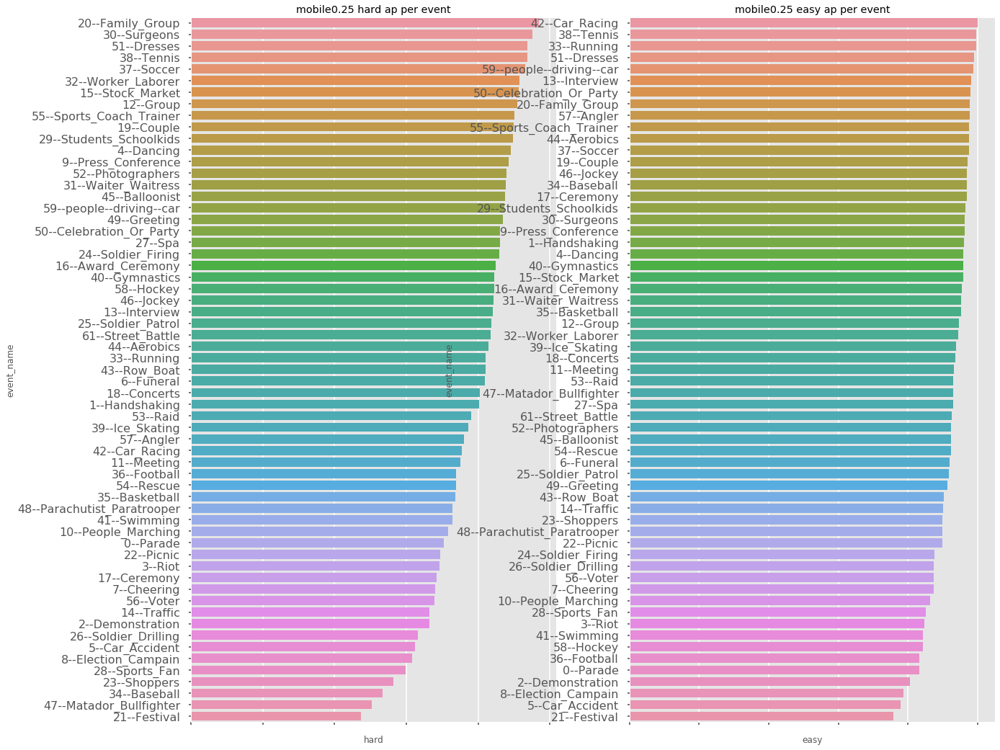

In [521]:
fig, ax = plt.subplots(figsize = (20, 18))
plt.subplot(1, 2, 1)
#plt.figure(figsize=(8, 15))
chart=sns.barplot(y='event_name', x='hard', data=df.sort_values('hard', ascending=False))
chart.set_xticklabels(chart.get_xticklabels(), rotation=45, horizontalalignment='right')
plt.title('mobile0.25 hard ap per event');

plt.subplot(1, 2, 2)
#plt.figure(figsize=(8, 15))
chart=sns.barplot(y='event_name', x='easy', data=df.sort_values('easy', ascending=False))
chart.set_xticklabels(chart.get_xticklabels(), rotation=45, horizontalalignment='right')
plt.title('mobile0.25 easy ap per event');

In [631]:
tmp_results = deepcopy(results)
for k in tmp_results['2--Demonstration']:
    tmp_results['2--Demonstration'][k] = []
evaluation(tmp_results, './widerface_evaluate/ground_truth/')



  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   2%|▏         | 1/61 [00:00<00:54,  1.10it/s]

Processing easy:   2%|▏         | 1/61 [00:00<00:54,  1.10it/s]

Processing easy:   3%|▎         | 2/61 [00:01<00:40,  1.45it/s]

Processing easy:   3%|▎         | 2/61 [00:01<00:40,  1.45it/s]

Processing easy:   5%|▍         | 3/61 [00:01<00:36,  1.58it/s]

Processing easy:   5%|▍         | 3/61 [00:01<00:36,  1.58it/s]

Processing easy:   7%|▋         | 4/61 [00:01<00:29,  1.94it/s]

Processing easy:   7%|▋         | 4/61 [00:01<00:29,  1.94it/s]

Processing easy:   8%|▊         | 5/61 [00:02<00:35,  1.59it/s]

Processing easy:   8%|▊         | 5/61 [00:02<00:35,  1.59it/s]

Processing easy:  10%|▉         | 6/61 [00:03<00:37,  1.45it/s]

Processing easy:  10%|▉         | 6/61 [00:03<00:37,  1.45it/s]

Processing easy:  11%|█▏        | 7/61 [00:03<00:28,  1.92it/s]

Processing easy:  11%|█▏        | 7/61 [00:03<00:28,  1.

Processing easy:  93%|█████████▎| 57/61 [00:17<00:01,  3.86it/s]

Processing easy:  95%|█████████▌| 58/61 [00:17<00:00,  4.19it/s]

Processing easy:  95%|█████████▌| 58/61 [00:17<00:00,  4.19it/s]

Processing easy:  97%|█████████▋| 59/61 [00:18<00:00,  4.00it/s]

Processing easy:  97%|█████████▋| 59/61 [00:18<00:00,  4.00it/s]

Processing easy:  98%|█████████▊| 60/61 [00:18<00:00,  4.09it/s]

Processing easy:  98%|█████████▊| 60/61 [00:18<00:00,  4.09it/s]

Processing easy: 100%|██████████| 61/61 [00:18<00:00,  3.25it/s]


  0%|          | 0/61 [00:00<?, ?it/s]

Processing medium:   0%|          | 0/61 [00:00<?, ?it/s]

Processing medium:   2%|▏         | 1/61 [00:00<00:56,  1.06it/s]

Processing medium:   2%|▏         | 1/61 [00:00<00:56,  1.06it/s]

Processing medium:   3%|▎         | 2/61 [00:01<00:42,  1.40it/s]

Processing medium:   3%|▎         | 2/61 [00:01<00:42,  1.40it/s]

Processing medium:   5%|▍         | 3/61 [00:01<00:37,  1.54it/s]

Processing medium:   5%|▍         | 3

Processing medium:  85%|████████▌ | 52/61 [00:16<00:02,  3.16it/s]

Processing medium:  85%|████████▌ | 52/61 [00:16<00:02,  3.16it/s]

Processing medium:  87%|████████▋ | 53/61 [00:16<00:02,  3.17it/s]

Processing medium:  87%|████████▋ | 53/61 [00:16<00:02,  3.17it/s]

Processing medium:  89%|████████▊ | 54/61 [00:16<00:02,  3.45it/s]

Processing medium:  89%|████████▊ | 54/61 [00:16<00:02,  3.45it/s]

Processing medium:  90%|█████████ | 55/61 [00:16<00:01,  3.47it/s]

Processing medium:  90%|█████████ | 55/61 [00:16<00:01,  3.47it/s]

Processing medium:  92%|█████████▏| 56/61 [00:17<00:01,  3.88it/s]

Processing medium:  92%|█████████▏| 56/61 [00:17<00:01,  3.88it/s]

Processing medium:  93%|█████████▎| 57/61 [00:17<00:01,  3.85it/s]

Processing medium:  93%|█████████▎| 57/61 [00:17<00:01,  3.85it/s]

Processing medium:  95%|█████████▌| 58/61 [00:17<00:00,  4.19it/s]

Processing medium:  95%|█████████▌| 58/61 [00:17<00:00,  4.19it/s]

Processing medium:  97%|█████████▋| 59/61 [00:17

Processing hard:  79%|███████▊  | 48/61 [00:14<00:04,  3.18it/s]

Processing hard:  79%|███████▊  | 48/61 [00:14<00:04,  3.18it/s]

Processing hard:  80%|████████  | 49/61 [00:15<00:03,  3.12it/s]

Processing hard:  80%|████████  | 49/61 [00:15<00:03,  3.12it/s]

Processing hard:  82%|████████▏ | 50/61 [00:15<00:03,  3.30it/s]

Processing hard:  82%|████████▏ | 50/61 [00:15<00:03,  3.30it/s]

Processing hard:  84%|████████▎ | 51/61 [00:15<00:03,  3.25it/s]

Processing hard:  84%|████████▎ | 51/61 [00:15<00:03,  3.25it/s]

Processing hard:  85%|████████▌ | 52/61 [00:16<00:02,  3.15it/s]

Processing hard:  85%|████████▌ | 52/61 [00:16<00:02,  3.15it/s]

Processing hard:  87%|████████▋ | 53/61 [00:16<00:02,  3.15it/s]

Processing hard:  87%|████████▋ | 53/61 [00:16<00:02,  3.15it/s]

Processing hard:  89%|████████▊ | 54/61 [00:16<00:02,  3.41it/s]

Processing hard:  89%|████████▊ | 54/61 [00:16<00:02,  3.41it/s]

Processing hard:  90%|█████████ | 55/61 [00:16<00:01,  3.43it/s]

Processing

==================== Results ====================
Easy   Val AP: 0.7867209182240281
Medium Val AP: 0.7500544852254767
Hard   Val AP: 0.5972597489987722


[0.7867209182240281, 0.7500544852254767, 0.5972597489987722]

In [632]:
tmp_results = deepcopy(results)
for k in tmp_results['27--Spa']:
    tmp_results['27--Spa'][k] = []
evaluation(tmp_results, './widerface_evaluate/ground_truth/')



  0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   0%|          | 0/61 [00:00<?, ?it/s]

Processing easy:   2%|▏         | 1/61 [00:00<00:54,  1.10it/s]

Processing easy:   2%|▏         | 1/61 [00:00<00:54,  1.10it/s]

Processing easy:   3%|▎         | 2/61 [00:01<00:41,  1.44it/s]

Processing easy:   3%|▎         | 2/61 [00:01<00:41,  1.44it/s]

Processing easy:   5%|▍         | 3/61 [00:01<00:36,  1.58it/s]

Processing easy:   5%|▍         | 3/61 [00:01<00:36,  1.58it/s]

Processing easy:   7%|▋         | 4/61 [00:01<00:29,  1.96it/s]

Processing easy:   7%|▋         | 4/61 [00:01<00:29,  1.96it/s]

Processing easy:   8%|▊         | 5/61 [00:02<00:34,  1.60it/s]

Processing easy:   8%|▊         | 5/61 [00:02<00:34,  1.60it/s]

Processing easy:  10%|▉         | 6/61 [00:03<00:37,  1.47it/s]

Processing easy:  10%|▉         | 6/61 [00:03<00:37,  1.47it/s]

Processing easy:  11%|█▏        | 7/61 [00:03<00:27,  1.95it/s]

Processing easy:  11%|█▏        | 7/61 [00:03<00:27,  1.

Processing easy:  93%|█████████▎| 57/61 [00:18<00:01,  3.84it/s]

Processing easy:  95%|█████████▌| 58/61 [00:19<00:00,  4.19it/s]

Processing easy:  95%|█████████▌| 58/61 [00:19<00:00,  4.19it/s]

Processing easy:  97%|█████████▋| 59/61 [00:19<00:00,  4.00it/s]

Processing easy:  97%|█████████▋| 59/61 [00:19<00:00,  4.00it/s]

Processing easy:  98%|█████████▊| 60/61 [00:19<00:00,  4.04it/s]

Processing easy:  98%|█████████▊| 60/61 [00:19<00:00,  4.04it/s]

Processing easy: 100%|██████████| 61/61 [00:20<00:00,  3.03it/s]


  0%|          | 0/61 [00:00<?, ?it/s]

Processing medium:   0%|          | 0/61 [00:00<?, ?it/s]

Processing medium:   2%|▏         | 1/61 [00:01<01:15,  1.27s/it]

Processing medium:   2%|▏         | 1/61 [00:01<01:15,  1.27s/it]

Processing medium:   3%|▎         | 2/61 [00:01<00:55,  1.06it/s]

Processing medium:   3%|▎         | 2/61 [00:01<00:55,  1.06it/s]

Processing medium:   5%|▍         | 3/61 [00:02<00:49,  1.17it/s]

Processing medium:   5%|▍         | 3

Processing medium:  85%|████████▌ | 52/61 [00:25<00:03,  2.31it/s]

Processing medium:  85%|████████▌ | 52/61 [00:25<00:03,  2.31it/s]

Processing medium:  87%|████████▋ | 53/61 [00:25<00:03,  2.33it/s]

Processing medium:  87%|████████▋ | 53/61 [00:26<00:03,  2.33it/s]

Processing medium:  89%|████████▊ | 54/61 [00:26<00:03,  2.11it/s]

Processing medium:  89%|████████▊ | 54/61 [00:26<00:03,  2.11it/s]

Processing medium:  90%|█████████ | 55/61 [00:27<00:02,  2.10it/s]

Processing medium:  90%|█████████ | 55/61 [00:27<00:02,  2.10it/s]

Processing medium:  92%|█████████▏| 56/61 [00:27<00:02,  2.49it/s]

Processing medium:  92%|█████████▏| 56/61 [00:27<00:02,  2.49it/s]

Processing medium:  93%|█████████▎| 57/61 [00:27<00:01,  2.25it/s]

Processing medium:  93%|█████████▎| 57/61 [00:27<00:01,  2.25it/s]

Processing medium:  95%|█████████▌| 58/61 [00:28<00:01,  2.70it/s]

Processing medium:  95%|█████████▌| 58/61 [00:28<00:01,  2.70it/s]

Processing medium:  97%|█████████▋| 59/61 [00:28

Processing hard:  79%|███████▊  | 48/61 [00:37<00:09,  1.31it/s]

Processing hard:  79%|███████▊  | 48/61 [00:37<00:09,  1.31it/s]

Processing hard:  80%|████████  | 49/61 [00:37<00:07,  1.54it/s]

Processing hard:  80%|████████  | 49/61 [00:37<00:07,  1.54it/s]

Processing hard:  82%|████████▏ | 50/61 [00:38<00:05,  1.84it/s]

Processing hard:  82%|████████▏ | 50/61 [00:38<00:05,  1.84it/s]

Processing hard:  84%|████████▎ | 51/61 [00:38<00:04,  2.03it/s]

Processing hard:  84%|████████▎ | 51/61 [00:38<00:04,  2.03it/s]

Processing hard:  85%|████████▌ | 52/61 [00:38<00:04,  1.98it/s]

Processing hard:  85%|████████▌ | 52/61 [00:38<00:04,  1.98it/s]

Processing hard:  87%|████████▋ | 53/61 [00:39<00:04,  1.88it/s]

Processing hard:  87%|████████▋ | 53/61 [00:39<00:04,  1.88it/s]

Processing hard:  89%|████████▊ | 54/61 [00:39<00:03,  2.16it/s]

Processing hard:  89%|████████▊ | 54/61 [00:39<00:03,  2.16it/s]

Processing hard:  90%|█████████ | 55/61 [00:40<00:02,  2.27it/s]

Processing

==================== Results ====================
Easy   Val AP: 0.9042382599542814
Medium Val AP: 0.8803860988615722
Hard   Val AP: 0.7386159649558977


[0.9042382599542814, 0.8803860988615722, 0.7386159649558977]

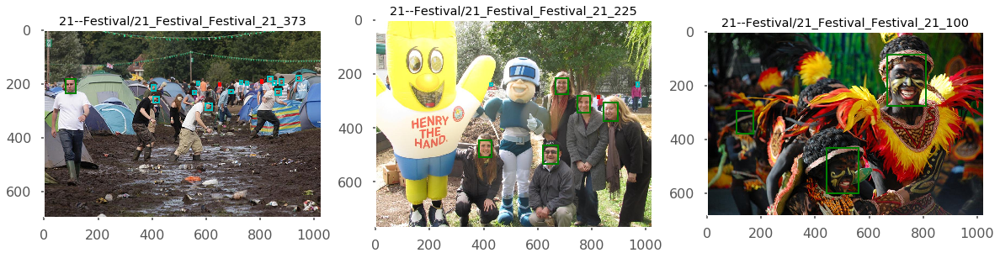

In [513]:
show_random_images(val[val['event_name']=='21--Festival'], 3, mode='val')

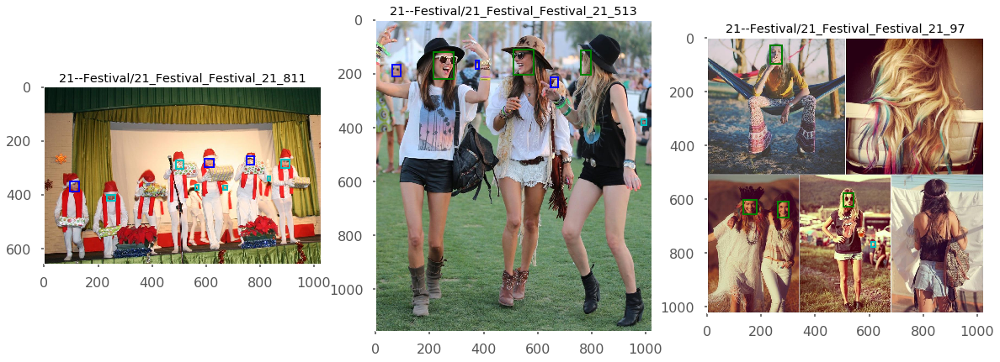

In [518]:
show_random_images(val[val['event_name']=='21--Festival'], 3, mode='val')

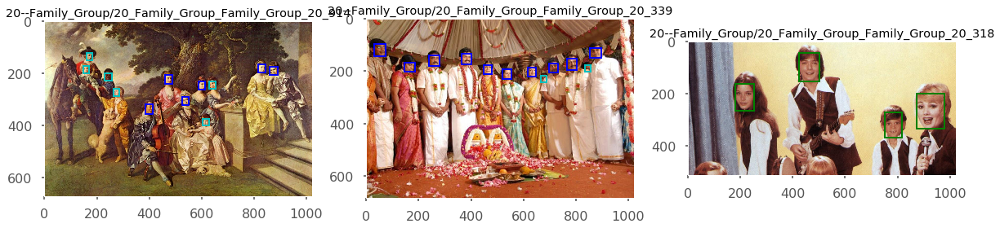

In [515]:
show_random_images(val[val['event_name']=='20--Family_Group'], 3, mode='val')

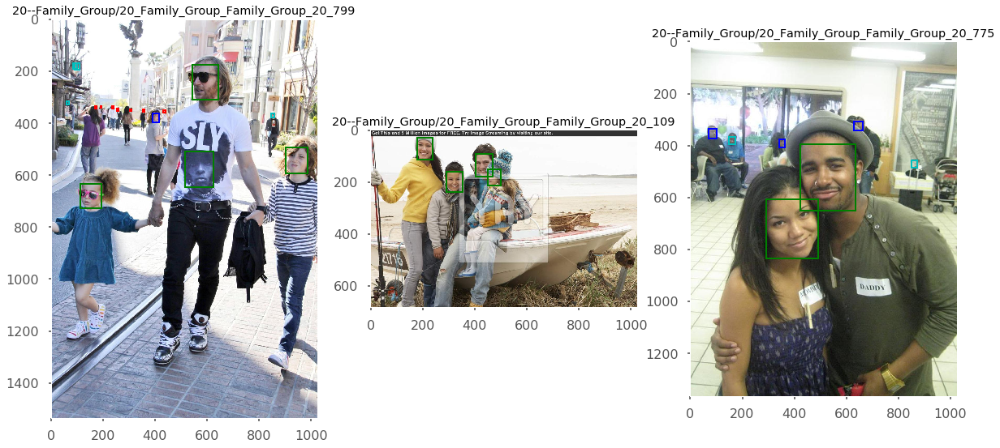

In [519]:
show_random_images(val[val['event_name']=='20--Family_Group'], 3, mode='val')

In [545]:
def show_preds(df, preds):
    row = df.iloc[0]
    #fig, ax = plt.subplots(figsize = (20, 8))
    img_path = f'{DATA_DIR}/val/images/{row.event_name}/{row.img_name}.jpg'
    img = cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB)
    
    fig, ax = plt.subplots(1, 2, figsize=(20, 10))
    
    #plt.subplot(1, 2, 1) 
    #plt.imshow(img)
    #plt.title('ground truth')
    #plt.grid(False)
    ax[0].imshow(img)
    ax[0].set_title('ground truth')
    ax[0].grid(False)
    
    ax[1].imshow(img)
    ax[1].set_title('Predictions')
    ax[1].grid(False)
    
    if True:
        for box_idx, bbox in enumerate(row.annotation):
            #print(bbox)
            edgecolor = 'r'
            if True:
                if box_idx in row.hard_gt:
                    edgecolor = 'c'
                if box_idx in row.medium_gt:
                    edgecolor = 'b'
                if box_idx in row.easy_gt:
                    edgecolor = 'g'
            rect = patches.Rectangle((bbox[0],bbox[1]),bbox[2]-bbox[0],bbox[3]-bbox[1],linewidth=2,edgecolor=edgecolor,facecolor='none')
            ax[0].add_patch(rect)

    bboxes = preds[row.event_name][row.img_name]
    for bbox in bboxes:
        #print(bbox)
        rect = patches.Rectangle((bbox[0],bbox[1]),bbox[2],bbox[3],linewidth=2,edgecolor='b',facecolor='none')
        ax[1].add_patch(rect)
    
    fig.show()


def show_random_preds(df, preds):
    show_preds(df.sample(1), preds)


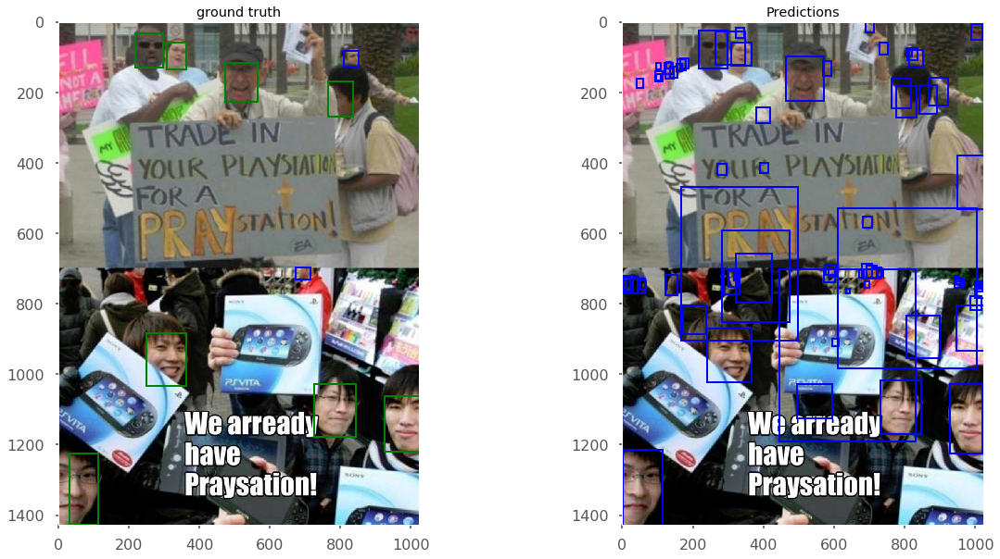

In [546]:
show_random_preds(val, results)

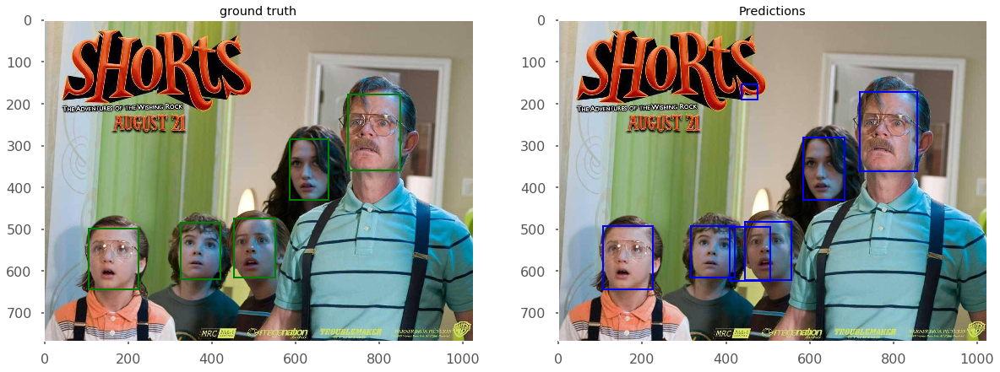

In [547]:
show_random_preds(val[val['event_name']=='20--Family_Group'], results)

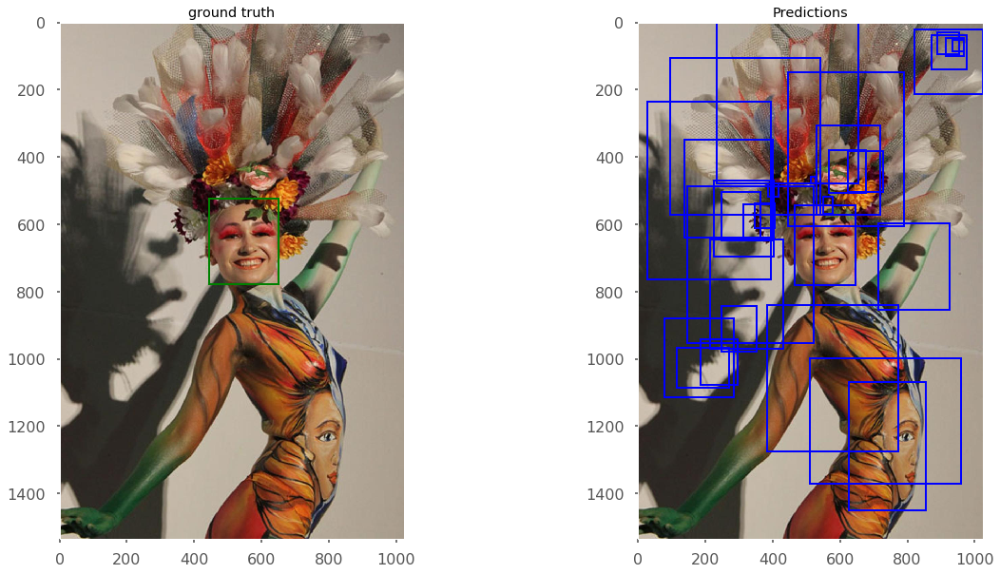

In [548]:
show_random_preds(val[val['event_name']=='21--Festival'], results)

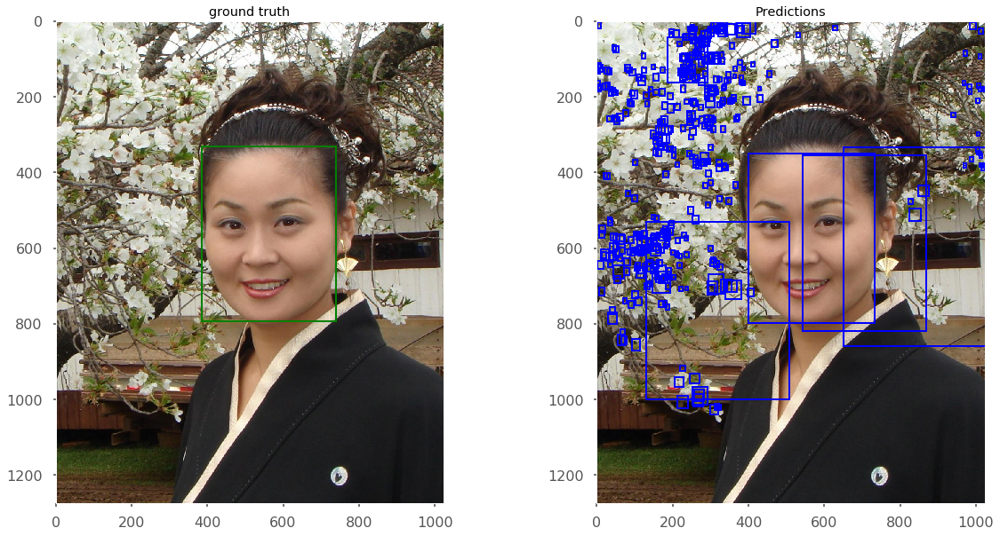

In [549]:
show_random_preds(val[val['event_name']=='21--Festival'], results)

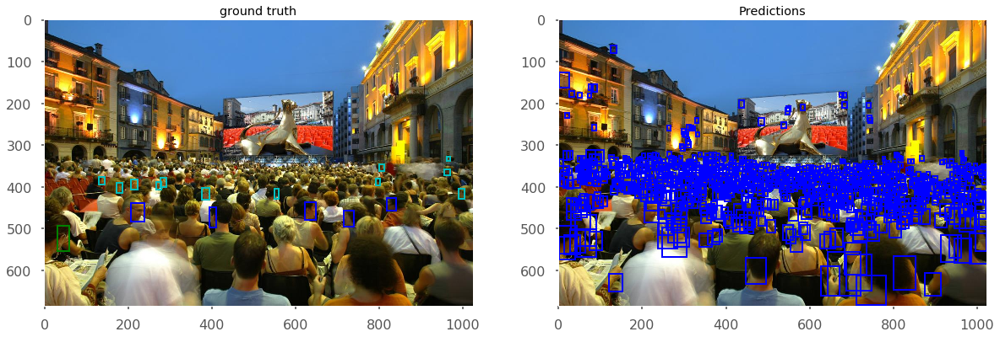

In [553]:
show_random_preds(val[val['event_name']=='21--Festival'], results)

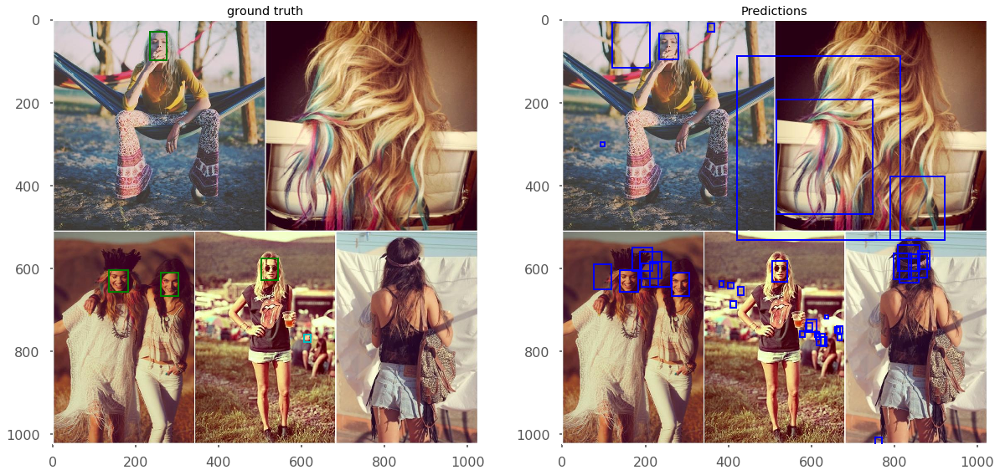

In [550]:
show_random_preds(val[val['event_name']=='21--Festival'], results)

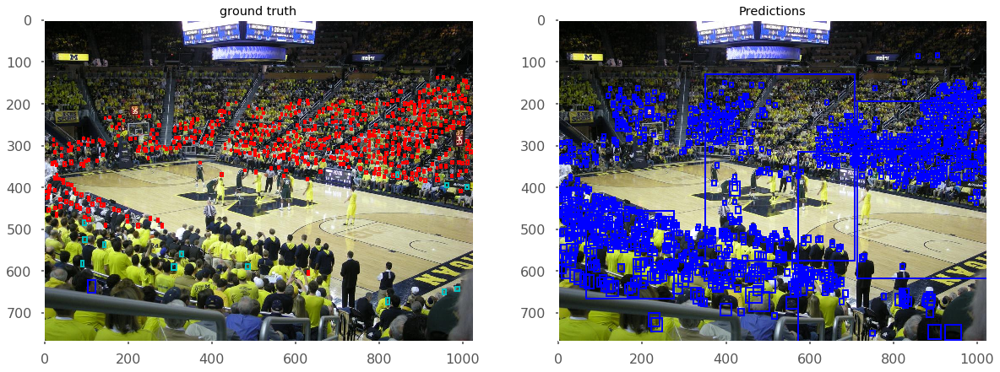

In [552]:
show_random_preds(val[val['num_bboxes']>500], results)

# Data augmentation

In [585]:
from data import WiderFaceDetection, detection_collate, preproc, cfg_mnet, cfg_re50
img_dim = 640
rgb_mean = (0, 0, 0) #(104, 117, 123)
dataset = WiderFaceDetection('./data/widerface/train/label.txt',preproc(img_dim, rgb_mean))

In [612]:
def show_data_aug(dataset, idx):
    img, anns = dataset[idx]
    aug_img = img.numpy().transpose(1,2,0).astype(np.int32)
    img_path = dataset.imgs_path[idx]
    orig_img = cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB)
        
    fig, ax = plt.subplots(1, 2, figsize=(20, 10))
    
    ax[0].imshow(orig_img)
    ax[0].set_title('original')
    ax[0].grid(False)
    
    ax[1].imshow(aug_img)
    ax[1].set_title('augmented')
    ax[1].grid(False)
    
    for ann in anns:
        bbox = ann * img_dim
        rect = patches.Rectangle((bbox[0],bbox[1]),bbox[2]-bbox[0],bbox[3]-bbox[1],linewidth=2,edgecolor='r',facecolor='none')
        ax[1].add_patch(rect)
        
        # Draw landmarks
        if bbox[4] > 0:
            for lm_idx in range(5):
                x, y = bbox[4:][lm_idx*2:lm_idx*2+2]
                lm = patches.Circle((x, y), radius=3, fill=True, color='g')
                ax[1].add_patch(lm)
    fig.show()

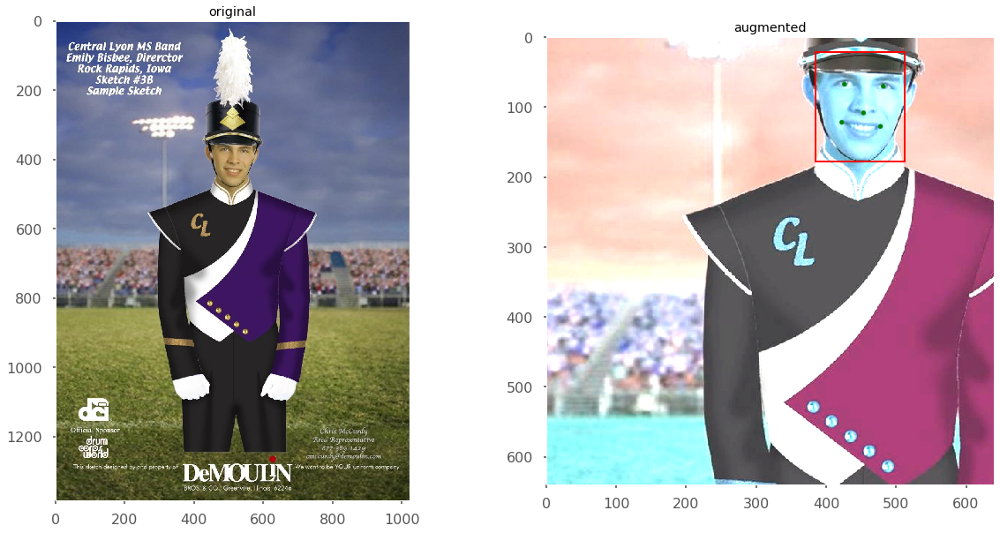

In [613]:
show_data_aug(dataset, 0)

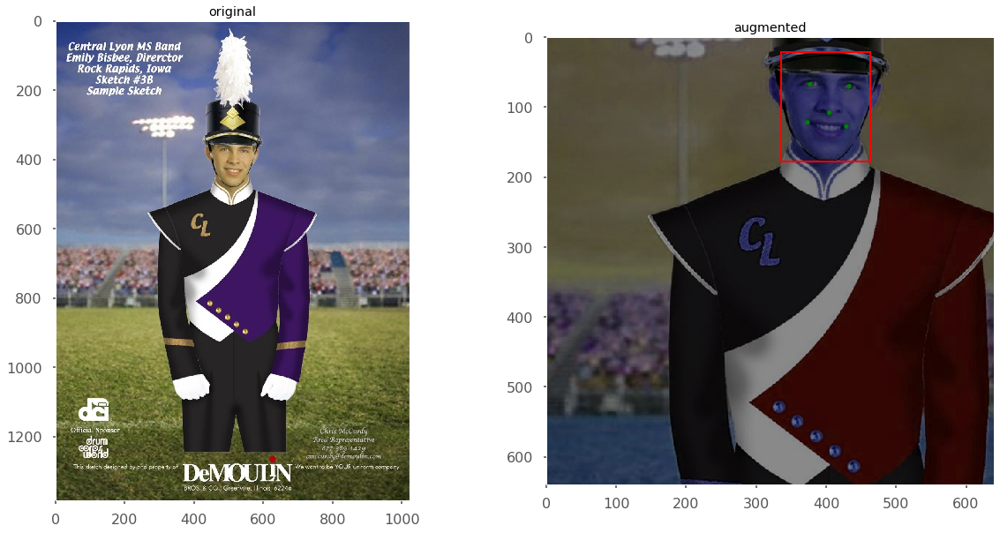

In [614]:
show_data_aug(dataset, 0)

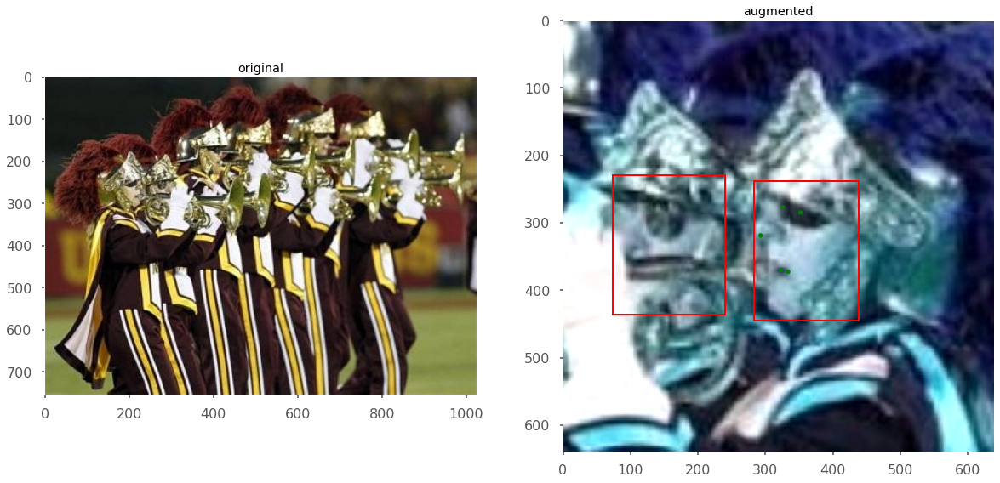

In [616]:
show_data_aug(dataset, 10)

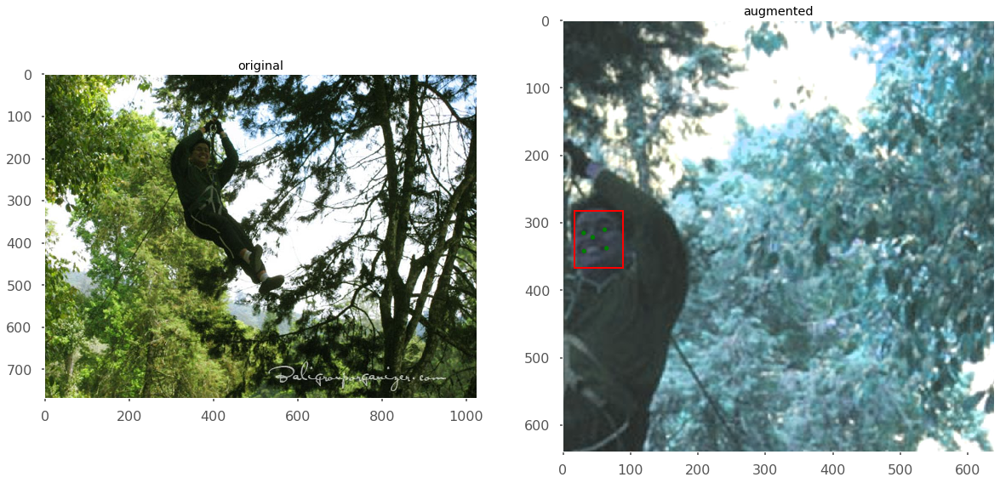

In [618]:
show_data_aug(dataset, 1000)

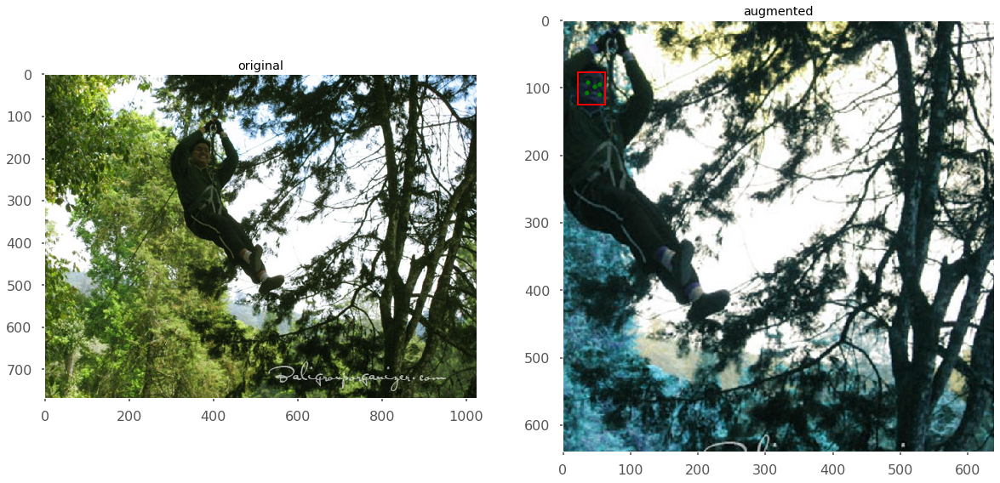

In [627]:
show_data_aug(dataset, 1000)

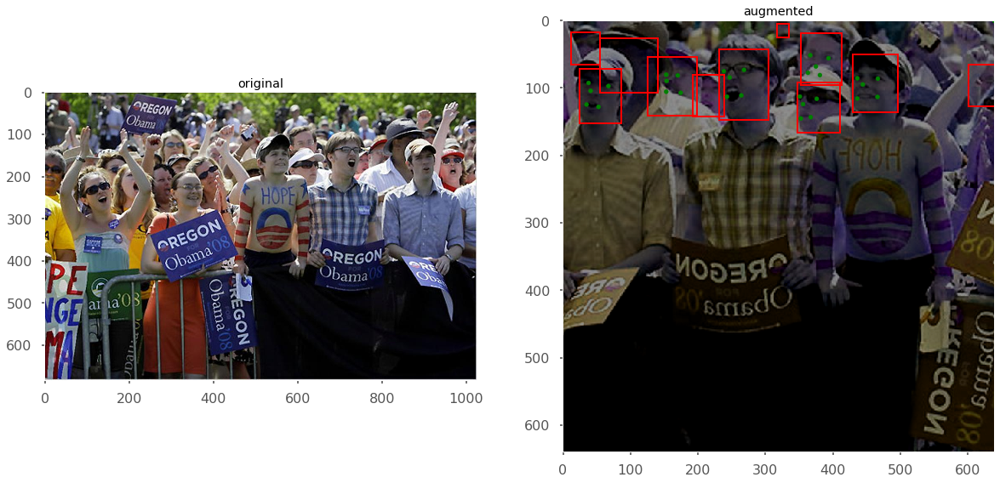

In [621]:
show_data_aug(dataset, 3000)

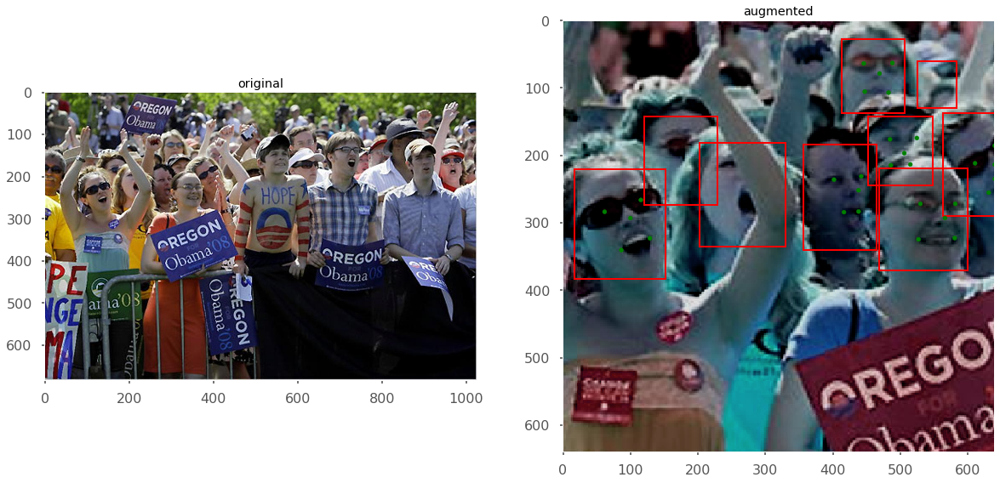

In [626]:
show_data_aug(dataset, 3000)